In [123]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as matcolor
import seaborn as sb
from patsy import dmatrices
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from imdb import IMDb
from imdb.Person import Person
from imdb.Company import Company
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
tmdb = pd.read_csv('tmdbclean.csv')

#Convert release date to date time
tmdb.info()
tmdb.sample(3)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4429 entries, 0 to 4428
Data columns (total 21 columns):
id                      4429 non-null int64
imdb_id                 4429 non-null object
popularity              4429 non-null float64
budget                  4429 non-null int64
revenue                 4429 non-null int64
original_title          4429 non-null object
cast                    4429 non-null object
homepage                1506 non-null object
director                4429 non-null object
tagline                 4055 non-null object
keywords                4248 non-null object
overview                4429 non-null object
runtime                 4429 non-null int64
genres                  4429 non-null object
production_companies    4429 non-null object
release_date            4429 non-null object
vote_count              4429 non-null int64
vote_average            4429 non-null float64
release_year            4429 non-null int64
budget_adj              4429 non-null floa

,id,imdb_id,popularity,budget,revenue,original_title,cast,homepage,director,tagline,keywords,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
1948,77805,tt1426329,0.765495,10000000,1585582,Lovelace,amanda seyfried|peter sarsgaard|hank azaria|ad...,NaN,rob epstein|jeffrey friedman,The truth goes deeper than you think.,biography|porno star,"Story of Linda Lovelace, who is used and abuse...",92,drama,helios-filmproduktion|animus films|millennium ...,8/8/13,147,6.0,2013,9.360334e+06,1.484158e+06
576,11439,tt1139328,1.107358,45000000,60222298,The Ghost Writer,ewan mcgregor|pierce brosnan|jon bernthal|kim ...,NaN,roman polanski,Read between the lies.,london|cia|war crimes|tony blair|author,A writer stumbles upon a long-hidden secret wh...,128,thriller|mystery,studio babelsberg|runteam ltd.|r.p. production...,2/12/10,357,6.5,2010,4.500000e+07,6.022230e+07
3885,1544,tt0421994,0.548181,7900000,2455831,Imagine Me & You,piper perabo|lena headey|matthew goode|celia i...,http://www.foxsearchlight.com/imaginemeandyou/,ol parker,There goes the bride.,london|flower shop|homosexuality|lesbian|lgbt,"During her wedding ceremony, Rachel notices Lu...",93,drama|comedy|romance,bbc films|filmstiftung nordrhein-westfalen|x-f...,2/1/05,97,6.7,2005,0.000000e+00,2.742091e+06


In [124]:
a = "{:02d}".format(8)
d = {'release_date': ['2/1/00', '12/22/95'], 'release_year': [2000, 1995]}
df = pd.DataFrame(data=d)
#df[df['release_date'].str.split('/').str[0].astype(int)>12]
df['release_date'] = (df['release_date'].str.split('/').str[1].apply(lambda x:"{:02d}".format(int(x))) +"/" + 
df['release_date'].str.split('/').str[0].apply(lambda x:"{:02d}".format(int(x))) + "/" +
df['release_year'].astype(str))

df

#Finding out whether release date is in MM/DD/yyy proper format
#tmdb[tmdb['release_date'].str.split('/').str[0].astype(int)>12]

,release_date,release_year
0,01/02/2000,2000
1,22/12/1995,1995


In [3]:

d = {'age': [1,2,3,4,5,6,7,8,9,10], 'marks': [10,20,30,40,50,60,70,80,80,100]}
df = pd.DataFrame(data=d)
df.sort_values('age').rolling(3).sum()

,age,marks
0,NaN,NaN
1,NaN,NaN
2,6.0,60.0
3,9.0,90.0
4,12.0,120.0
5,15.0,150.0
6,18.0,180.0
7,21.0,210.0
8,24.0,230.0
9,27.0,260.0


In [125]:
tmdb['release_date'] = (tmdb['release_date'].str.split('/').str[1].apply(lambda x:"{:02d}".format(int(x))) +"/" + 
tmdb['release_date'].str.split('/').str[0].apply(lambda x:"{:02d}".format(int(x))) + "/" +
tmdb['release_year'].astype(str))

In [126]:
tmdb['release_date'] = pd.to_datetime(tmdb['release_date'])


In [127]:
tmdb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4429 entries, 0 to 4428
Data columns (total 21 columns):
id                      4429 non-null int64
imdb_id                 4429 non-null object
popularity              4429 non-null float64
budget                  4429 non-null int64
revenue                 4429 non-null int64
original_title          4429 non-null object
cast                    4429 non-null object
homepage                1506 non-null object
director                4429 non-null object
tagline                 4055 non-null object
keywords                4248 non-null object
overview                4429 non-null object
runtime                 4429 non-null int64
genres                  4429 non-null object
production_companies    4429 non-null object
release_date            4429 non-null datetime64[ns]
vote_count              4429 non-null int64
vote_average            4429 non-null float64
release_year            4429 non-null int64
budget_adj              4429 non-n

In [7]:
tmdb.describe()

,id,popularity,budget,revenue,runtime,vote_count,vote_average,release_year,budget_adj,revenue_adj
count,4429.000000,4429.000000,4.429000e+03,4.429000e+03,4429.000000,4429.000000,4429.000000,4429.000000,4.429000e+03,4.429000e+03
mean,39400.144051,1.086938,3.485778e+07,9.752523e+07,108.551592,468.627907,6.135561,2000.592910,3.944462e+07,1.218403e+08
std,66722.379097,1.227086,4.018173e+07,1.652600e+08,20.446271,823.065587,0.799496,11.568236,4.399697e+07,2.046366e+08
min,5.000000,0.001117,1.000000e+00,2.000000e+00,15.000000,10.000000,2.100000,1960.000000,0.000000e+00,0.000000e+00
25%,7270.000000,0.429125,9.000000e+06,1.200000e+07,95.000000,58.000000,5.600000,1994.000000,8.485830e+06,1.135043e+07
50%,11418.000000,0.732485,2.100000e+07,3.994678e+07,105.000000,172.000000,6.200000,2003.000000,2.566099e+07,4.953381e+07
75%,37094.000000,1.274285,4.500000e+07,1.113408e+08,118.000000,493.000000,6.700000,2010.000000,5.519998e+07,1.420703e+08
max,417859.000000,24.949134,4.250000e+08,2.781506e+09,594.000000,9767.000000,8.400000,2015.000000,4.250000e+08,2.827124e+09


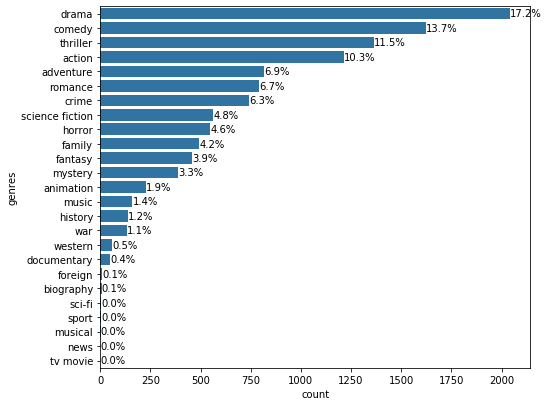

In [8]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
base_color = sb.color_palette()[0]
genrecounts = tmdbgenres['genres'].value_counts()
genreorder = genrecounts.index
fig = plt.figure()
ax = fig.add_axes([.125, .125, 0.995, 1.255])
sb.countplot(data = tmdbgenres, y = 'genres', color = base_color,order = genreorder,ax=ax);
for i in range(genrecounts.shape[0]):
    count = genrecounts[i]
    pctstring = '{:0.1f}%'.format(100*count/tmdbgenres.shape[0])
    plt.text(count+1,i,pctstring,va = 'center');
#Drama comedy thriller action makes up for more than 50% of data

<h6>Drama comedy thriller action makes up for more than 50% of data with drama being the highest</h6>

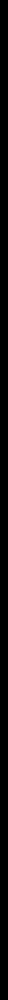

In [9]:
tmdbcast = tmdb.copy()
tmdbcast = tmdbcast.assign(cast=tmdbcast.cast.str.split('|')).explode('cast')
base_color = sb.color_palette()[0]
castcounts = tmdbcast['cast'].value_counts()
castorder = castcounts.index
fig = plt.figure(figsize=(4,10))
ax = fig.add_axes([.125, .125, .995,90.955])
sb.countplot(data = tmdbcast, y = 'cast', color = base_color,order = castorder,ax=ax);
for i in range(castcounts.shape[0]):
    count = castcounts[i]
    pctstring = '{:0.1f}%'.format(100*count/tmdbcast.shape[0])
    plt.text(count+1,i,pctstring,va = 'center');
#Drama comedy thriller action makes up for more than 50% of data

In [10]:
print(castcounts.describe())
print()
print(castcounts.nlargest(25))
print()
print(castcounts.quantile(0.78))

count    9723.000000
mean        2.508382
std         3.981650
min         1.000000
25%         1.000000
50%         1.000000
75%         2.000000
max        57.000000
Name: cast, dtype: float64

robert de niro        57
bruce willis          50
samuel l. jackson     48
nicolas cage          45
morgan freeman        40
matt damon            37
sylvester stallone    37
brad pitt             37
robin williams        37
tom hanks             37
harrison ford         37
liam neeson           35
johnny depp           35
gene hackman          35
eddie murphy          34
tom cruise            33
denzel washington     33
julia roberts         33
nicole kidman         33
julianne moore        33
willem dafoe          32
meryl streep          32
mark wahlberg         31
john goodman          30
owen wilson           30
Name: cast, dtype: int64

2.0


<h6>Top 25 actors with most movies described as above
67% actors have done only one movie
11% actors have done 2 movies</h6>

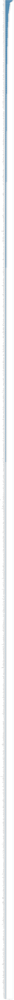

In [11]:
tmdbdirector = tmdb.copy()
tmdbdirector = tmdbdirector.assign(director=tmdbdirector.director.str.split('|')).explode('director')
base_color = sb.color_palette()[0]
directorcounts = tmdbdirector['director'].value_counts()
directororder = directorcounts.index
fig = plt.figure(figsize=(4,10))
ax = fig.add_axes([.125, .125, .995, 50.255])
sb.countplot(data = tmdbdirector, y = 'director', color = base_color,order = directororder,ax=ax);
for i in range(directorcounts.shape[0]):
    count = directorcounts[i]
    pctstring = '{:0.2f}%'.format(100*count/tmdbdirector.shape[0])
    plt.text(count+1,i,pctstring,va = 'center');

In [12]:
print(directorcounts.describe())
print()
print(directorcounts.nlargest(25))
print()
print(directorcounts.quantile(0.54))
print(directorcounts.quantile(0.74))

count    1983.000000
mean        2.408976
std         2.614996
min         1.000000
25%         1.000000
50%         1.000000
75%         3.000000
max        28.000000
Name: director, dtype: float64

steven spielberg        28
clint eastwood          26
woody allen             25
ridley scott            22
ron howard              19
tim burton              17
martin scorsese         17
joel schumacher         17
steven soderbergh       17
robert rodriguez        17
brian de palma          16
robert zemeckis         16
renny harlin            16
oliver stone            15
wes craven              15
richard donner          15
walter hill             15
ivan reitman            14
john carpenter          14
joel coen               14
tony scott              14
barry levinson          13
francis ford coppola    13
rob reiner              13
peter farrelly          13
Name: director, dtype: int64

2.0
3.0


<h6>Top 25 directors who have directed most movies as above</h6>
<h6>54% of directors have directed 1 movie,20% of directors have directed only 2 movies</h6>

<h6>Univariate exploration of production companies</h6>

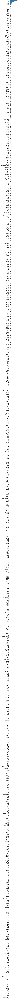

In [13]:
tmdbproduction_companies = tmdb.copy()
tmdbproduction_companies = tmdbproduction_companies.assign(production_companies=tmdbproduction_companies.production_companies.str.split('|')).explode('production_companies')
tmdbproduction_companies.drop(tmdbproduction_companies[tmdbproduction_companies.production_companies.str.strip() == ''].index,inplace = True)
base_color = sb.color_palette()[0]
production_companiescounts = tmdbproduction_companies['production_companies'].value_counts()
production_companiesorder = production_companiescounts.index
fig = plt.figure(figsize=(4,10))
ax = fig.add_axes([.125, .125, .995, 50.255])
sb.countplot(data = tmdbproduction_companies, y = 'production_companies', color = base_color,order = production_companiesorder,ax=ax);
for i in range(production_companiescounts.shape[0]):
    count = production_companiescounts[i]
    pctstring = '{:0.2f}%'.format(100*count/tmdbproduction_companies.shape[0])
    plt.text(count+1,i,pctstring,va = 'center');

In [14]:
print(production_companiescounts.describe())
print()
print(production_companiescounts.nlargest(25))
print()
print(production_companiescounts.quantile(0.65))
print(production_companiescounts.quantile(0.80))

count    3573.000000
mean        3.316261
std        13.646684
min         1.000000
25%         1.000000
50%         1.000000
75%         2.000000
max       369.000000
Name: production_companies, dtype: float64

universal pictures                        369
warner bros.                              367
paramount pictures                        314
twentieth century fox film corporation    226
columbia pictures                         210
new line cinema                           169
touchstone pictures                       133
walt disney pictures                      133
metro-goldwyn-mayer (mgm)                 128
columbia pictures corporation             108
relativity media                          106
miramax films                              92
tristar pictures                           86
village roadshow pictures                  79
dreamworks skg                             77
regency enterprises                        74
dimension films                            57
amblin

<h6>Top 25 production companies who have produced most movies as above</h6>
<h6>65% production companies have produced only one movie,while 15% of production companies have produced 2 movies</h6>

<h6>Univariate exploration of budget </h6>

(100000, 3000000000.0)

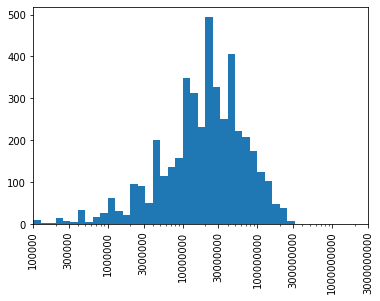

In [15]:
# tmdbbudget = tmdb.copy()
# tmdbbudget['budget'] = tmdbbudget['budget'] / 100
# bins  = np.arange(0,tmdbbudget['budget'].max()+100000,100000)
# plt.hist(data = tmdbbudget,x = 'budget',bins = bins);
np.log10(tmdb['budget'].describe())
tmdbbudget = tmdb.copy()
bins  = 10 ** np.arange(0,9+0.1,0.1)
ticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
labels = ['{}'.format(val) for val in ticks]
plt.hist(data = tmdbbudget,x = 'budget',bins = bins);
plt.xscale('log');
plt.xticks(ticks, labels)
plt.xticks(rotation = 90)
plt.xlim(xmin = 100000)

<h6>Most of the movies have budget that lies between 3 million and 100 million</h6>
<h6>Peak is observed in the graph between 20 million and 25 million</h6>

<h6>Univariate exploration of revenue</h6>

(10000.0, 3000000000)

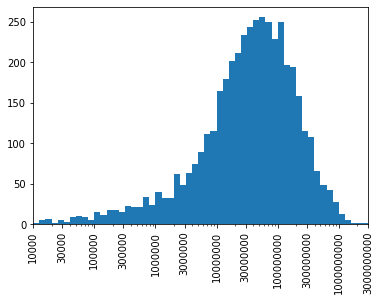

In [107]:
tmdbrevenue = tmdb.copy()
# tmdbrevenue['revenue'] = tmdbrevenue['revenue'] / 100
# bins  = np.arange(0,tmdbrevenue['revenue'].max()+1000000,1000000)
# plt.hist(data = tmdbrevenue,x = 'revenue',bins= bins);
np.log10(tmdbrevenue['revenue'].describe())
bins  = 10 ** np.arange(0,10+0.1,0.1)
ticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
labels = ['{}'.format(val) for val in ticks]
plt.hist(data = tmdbrevenue,x = 'revenue',bins = bins);
plt.xscale('log');
plt.xticks(ticks, labels)
plt.xticks(rotation = 90)
plt.xlim(xmin = 10000)
plt.xlim(xmax = 3000000000)

<h6>Most of the movies have revenue that lies between 3 million and 300 million</h6>
<h6>Peak of the graph is there between 30 million and 100 million</h6>

<h6>Univariate exploration of popularity </h6>

(0.03, 41.68693834703394)

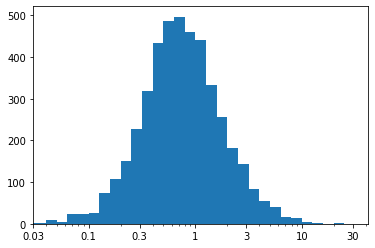

In [17]:
#plt.hist(data = tmdb,x = 'popularity',bins=100);
np.log10(tmdb['popularity'].describe())
bins  = 10 ** np.arange(-3,1.4+0.1,0.1)
ticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
labels = ['{}'.format(val) for val in ticks]
plt.hist(data = tmdb,x = 'popularity',bins = bins);
plt.xscale('log');
plt.xticks(ticks, labels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 0.03)

<h6>Popularity is log normally distributed</h6>
<h6>Most of the movies have popularity between 0.1 and 3</h6>

<h6>Univariate exploration of release year</h6>

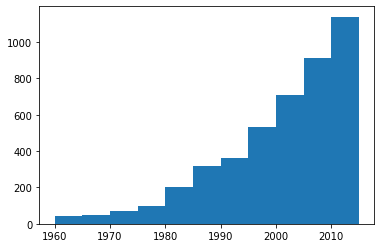

In [18]:
bins  = np.arange(1960,tmdb['release_year'].max()+5,5)
plt.hist(data = tmdb,x = 'release_year',bins=bins);

<h6>The distribution of the data for release year is right skewed and follows an upward trend indicating movies released per year is increasing constantly which makes sense</h6>

<h6>Univariate exploration of runtime</h6>

(30, 570)

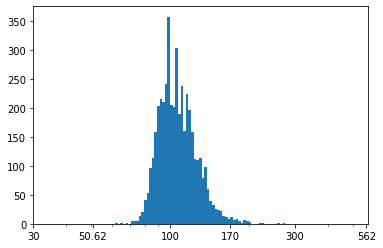

In [19]:
# tmdb['runtime'].describe()
# plt.hist(data = tmdb,x = 'runtime',bins=50);
np.log10(tmdb['runtime'].describe())
bins  = 10 ** np.arange(1.16,2.78+0.01,0.01)
ticks = [0.01,0.017,0.03,0.0562,0.1,0.17,0.3,0.562,1,1.7,3,5.62,10,17,30,50.62,100,170,300,562,1000]
labels = ['{}'.format(val) for val in ticks]
plt.hist(data = tmdb,x = 'runtime',bins = bins);
plt.xscale('log');
plt.xticks(ticks, labels);
plt.xticks(rotation = 0)
plt.xlim(xmin = 30,xmax=570)

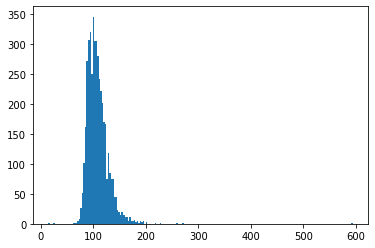

In [20]:
plt.hist(data = tmdb,x = 'runtime',bins=200);

<h6>Most of the data lies between 50.62 and 170 minutes of runtime</h6>
<h6>Peak is observed around 100</h6>

<h6>Univariate exploration of vote count</h6>

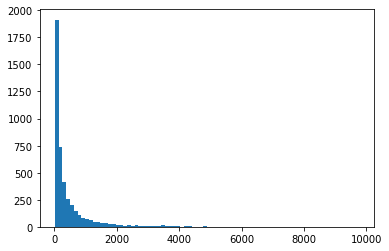

In [21]:
tmdb['vote_count'].describe()
plt.hist(data = tmdb,x = 'vote_count',bins=80);

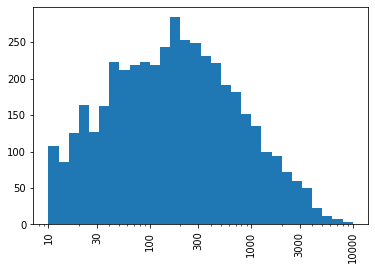

In [22]:
np.log10(tmdb['vote_count'].describe())
bins  = 10 ** np.arange(1,3.99+0.1,0.1)
ticks = [10, 30, 100, 300, 1000,3000,10000]
labels = ['{}'.format(val) for val in ticks]
plt.hist(data = tmdb,x = 'vote_count',bins = bins);
plt.xscale('log');
plt.xticks(ticks, labels);
plt.xticks(rotation = 90);
#Check whic distribution is better during regression

<h6>Univariate exploration of vote average</h6>

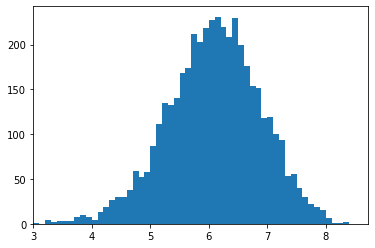

In [23]:
bins  = np.arange(2,tmdb['vote_average'].max()+0.1,0.1)
plt.hist(data = tmdb,x = 'vote_average',bins=bins);
plt.xlim(xmin=3);
#plt.xscale('log', basex=2)

<h6>Counts of vote average is normally distributed with peak around 6</h6>

<h3>Bivariate exploration of data</h3>

<h6>Budget vs revenue </h6>

Text(0, 0.5, 'Revenue in dollars')

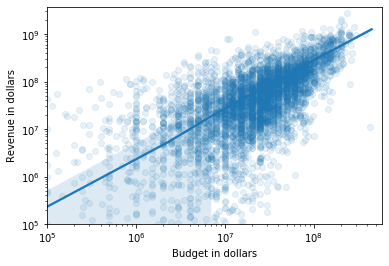

In [24]:
tmdbbr =tmdb.copy()
sb.regplot(data = tmdbbr, x = 'budget', y = 'revenue', scatter_kws = {'alpha' : 1/10},x_jitter = 1000)
plt.xscale('log');
plt.yscale('log');
plt.xlim(xmin = 100000)
plt.ylim(ymin = 100000)
plt.xlabel('Budget in dollars')
plt.ylabel('Revenue in dollars')

In [25]:
tmdbbr['logbudget'] = np.log10(tmdbbr['budget'])
tmdbbr['logrevenue'] = np.log10(tmdbbr['revenue'])
tmdbbr[['budget','revenue','logbudget','logrevenue']].query('budget>100000 & revenue > 10000').corr()

,budget,revenue,logbudget,logrevenue
budget,1.000000,0.687830,0.772616,0.548069
revenue,0.687830,1.000000,0.487270,0.624168
logbudget,0.772616,0.487270,1.000000,0.607661
logrevenue,0.548069,0.624168,0.607661,1.000000


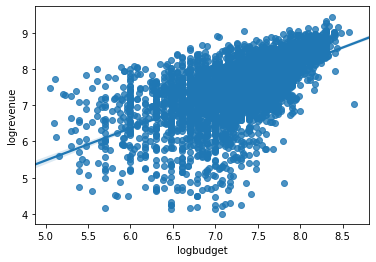

In [26]:
sb.regplot(data = tmdbbr.query('budget>100000 & revenue > 10000'), x = 'logbudget', y = 'logrevenue')

Text(0, 0.5, 'Revenue in dollars')

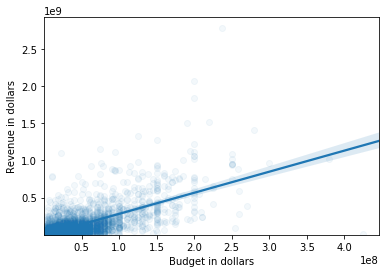

In [27]:
tmdbbr =tmdb.copy()
sb.regplot(data = tmdbbr, x = 'budget', y = 'revenue', scatter_kws = {'alpha' : 1/20},x_jitter = 1)
plt.xlim(xmin = 100000)
plt.ylim(ymin = 10000)
plt.xlabel('Budget in dollars')
plt.ylabel('Revenue in dollars')

<h6> Heatmap of budget vs revenue </h6>

Text(0.5, 1.0, 'Budget vs Revenue')

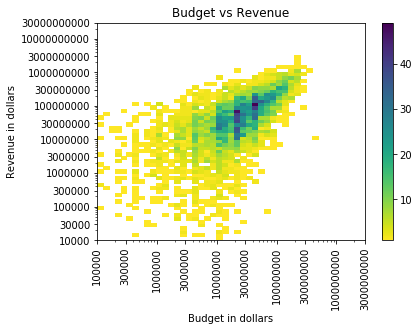

In [28]:
tmdbbr = tmdb.copy()
xbins  = 10 ** np.arange(0,9+0.1,0.1)
xticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbbr, x = 'budget', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 90)
plt.xlim(xmin = 100000)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Budget in dollars')
plt.ylabel('Revenue in dollars') 
plt.title('Budget vs Revenue')

<h6>From the plot revenue seems to be increasing with budget,however revenue seems to be distributed a lot for a given budget </h6>

<h6> Revenue vs popularity</h6>

Text(0.5, 1.0, 'Popularity vs Revenue')

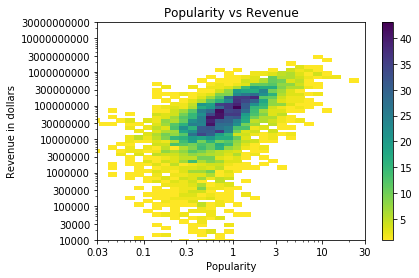

In [29]:
tmdbpr = tmdb.copy()
xbins  = 10 ** np.arange(-3,1.4+0.1,0.1)
xticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'popularity', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 0.03)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Popularity')
plt.ylabel('Revenue in dollars') 
plt.title('Popularity vs Revenue')

<h6>From the plot revenue seems to be increasing with popularity,however revenue seems to be distributed a lot for a given popularity </h6>

In [30]:
tmdbbr['logpopularity'] = np.log10(tmdbbr['popularity'])
tmdbbr['logrevenue'] = np.log10(tmdbbr['revenue'])
tmdbbr[['popularity','revenue','logpopularity','logrevenue']].query('popularity>=0.03 & revenue > 10000').corr()

,popularity,revenue,logpopularity,logrevenue
popularity,1.000000,0.646417,0.802469,0.463512
revenue,0.646417,1.000000,0.552861,0.622919
logpopularity,0.802469,0.552861,1.000000,0.564751
logrevenue,0.463512,0.622919,0.564751,1.000000


Text(0, 0.5, 'Revenue in dollars')

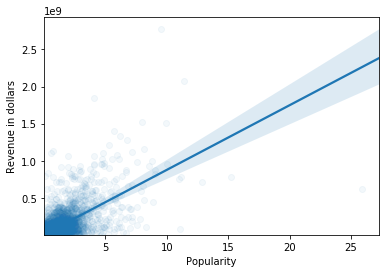

In [31]:
tmdbbr =tmdb.copy()
sb.regplot(data = tmdbbr, x = 'popularity', y = 'revenue', scatter_kws = {'alpha' : 1/20},x_jitter = 1)
plt.xlim(xmin = 0.03)
plt.ylim(ymin = 10000)
plt.xlabel('Popularity')
plt.ylabel('Revenue in dollars')

In [32]:
tmdb['popularity'].describe()

count    4429.000000
mean        1.086938
std         1.227086
min         0.001117
25%         0.429125
50%         0.732485
75%         1.274285
max        24.949134
Name: popularity, dtype: float64

(0, 5)

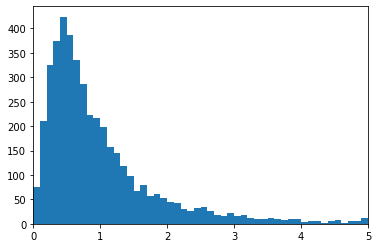

In [33]:
tmdbpop = tmdb.copy()
bins  = np.arange(0,tmdbpop['popularity'].max()+0.1,0.1)
plt.hist(data = tmdbpop,x = 'popularity',bins= bins);
plt.xlim(xmin=0,xmax=5)

(0, 500000)

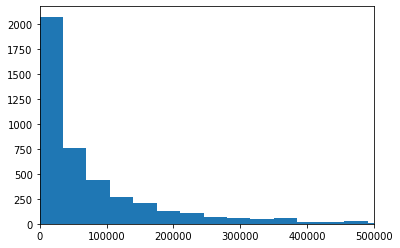

In [34]:
tmdbrevenue = tmdb.copy()
tmdbrevenue['revenue'] = tmdbrevenue['revenue']/1000
bins  = np.arange(0,tmdbrevenue['revenue'].max()+35000,35000)
plt.hist(data = tmdbrevenue,x = 'revenue',bins= bins);
plt.xlim(xmin=0,xmax=500000)

In [35]:
tmdbrevenue = tmdb.copy()
tmdbrevenue['revenue'] = tmdbrevenue['revenue']/1000
tmdbrevenue['revenue'].describe()

count    4.429000e+03
mean     9.752523e+04
std      1.652600e+05
min      2.000000e-03
25%      1.200000e+04
50%      3.994678e+04
75%      1.113408e+05
max      2.781506e+06
Name: revenue, dtype: float64

<h6>Budget vs Popularity</h6>

Text(0.5, 1.0, 'Popularity vs Budget')

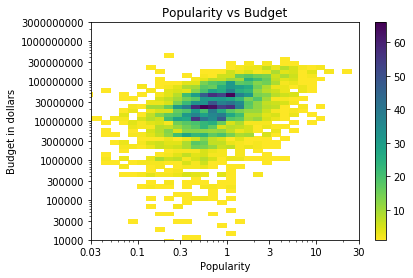

In [36]:
tmdbpr = tmdb.copy()
xbins  = 10 ** np.arange(-3,1.4+0.1,0.1)
xticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,9+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'popularity', y = 'budget',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 0.03)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Popularity')
plt.ylabel('Budget in dollars') 
plt.title('Popularity vs Budget')

<h6>From the plot budget seems to be increasing with popularity,however budget seems to be distributed a lot for a given popularity </h6>

In [37]:
tmdbpr['logpopularity'] = np.log10(tmdbpr['popularity'])
tmdbpr['logbudget'] = np.log10(tmdbpr['budget'])
tmdbpr[['popularity','budget','logpopularity','logbudget']].query('popularity>=0.03 & budget > 10000').corr()

,popularity,budget,logpopularity,logbudget
popularity,1.000000,0.476389,0.802151,0.350218
budget,0.476389,1.000000,0.471616,0.750749
logpopularity,0.802151,0.471616,1.000000,0.441787
logbudget,0.350218,0.750749,0.441787,1.000000


<h6>Revenue vs years</h6>

Text(0.5, 1.0, 'Year vs Revenue')

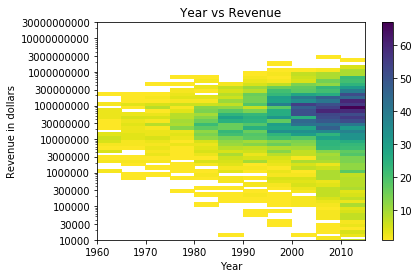

In [38]:
tmdbpr = tmdb.copy()
xbins  = np.arange(1960,tmdbpr['release_year'].max()+5,5)
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'release_year', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Year')
plt.ylabel('Revenue in dollars') 
plt.title('Year vs Revenue')

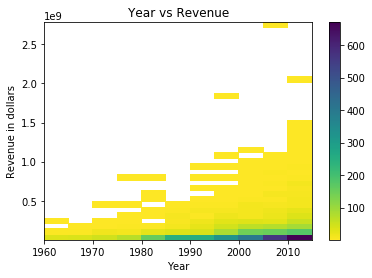

In [39]:
tmdbpr = tmdb.copy()
xbins  = np.arange(1960,tmdbpr['release_year'].max()+5,5)
plt.hist2d(data = tmdbpr, x = 'release_year', y = 'revenue',bins = [xbins, 40], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.ylim(ymin = 10000)
plt.xlabel('Year')
plt.ylabel('Revenue in dollars') 
plt.title('Year vs Revenue');

<h6>Revenue seems to be distributed for a given year,but the distribution seems to show upward trend as year is increasing</h6>

<h6>Line Plot of revenue vs year </h6>

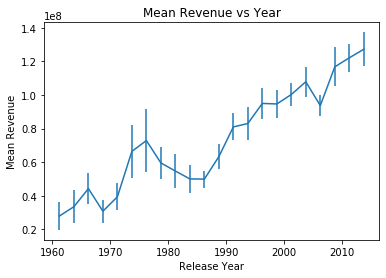

In [40]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['revenue'].groupby(data_xbins).mean()
y_std = tmdbby['revenue'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Revenue');
plt.title('Mean Revenue vs Year');

<h6>The mean revenue seems to be increasing over the years with a dip between 1980 to 1990</h6>

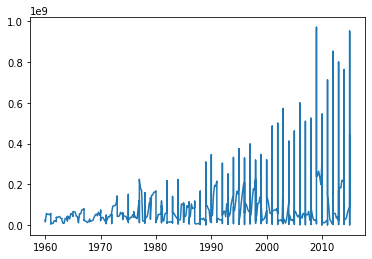

In [41]:
tmdbby =tmdb.copy()
#compute statistics in a rolling window
x_winmean = tmdbby[['release_year','revenue']].sort_values('release_year').rolling(5).mean()['release_year']
y_median = tmdbby[['release_year','revenue']].sort_values('release_year').rolling(5).mean()['revenue']
base_color = sb.color_palette()[0]
line_color = sb.color_palette('dark')[0]
plt.errorbar(x = x_winmean, y = y_median);

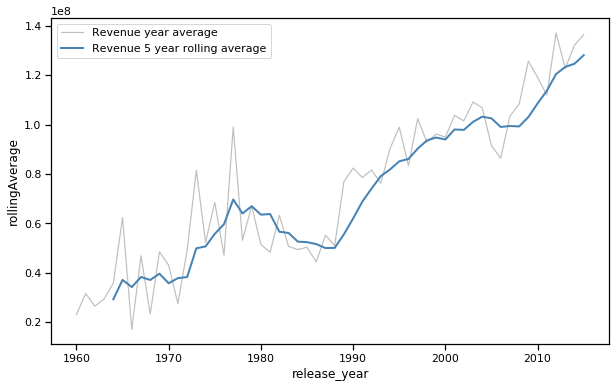

In [42]:
tmdbry =tmdb.copy()
tmdbry = tmdbby[['release_year','revenue']].groupby('release_year').mean().reset_index()
tmdbry["rollingAverage"] = tmdbry["revenue"].rolling(window = 5).mean()
tmdbry.reset_index(inplace = True, drop = True)

with sb.plotting_context("notebook"):
    #create a matplotlib figure and axes
    fig, ax = plt.subplots(figsize = (10,6))

    #plot the global data with a lineplot
    sb.lineplot(x = "release_year", y = "revenue", data = tmdbry, label = "Revenue year average", alpha = 0.5,
                 color = "grey", lw = 1.2)
    sb.lineplot(x = "release_year", y = "rollingAverage", data = tmdbry, label = "Revenue 5 year rolling average",
                 color = "steelblue", lw = 2)

In [43]:
tmdbpr['logrevenue'] = np.log10(tmdbpr['revenue'])
tmdbpr[['release_year','revenue','logrevenue']].query('revenue > 10000').corr()

,release_year,revenue,logrevenue
release_year,1.000000,0.147171,0.041209
revenue,0.147171,1.000000,0.622607
logrevenue,0.041209,0.622607,1.000000


<h6>Budget vs year</h6>

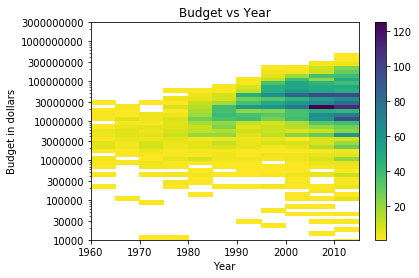

In [44]:
tmdbpr = tmdb.copy()
xbins  = np.arange(1960,tmdbpr['release_year'].max()+5,5)
ybins  = 10 ** np.arange(0,9+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'release_year', y = 'budget',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Year')
plt.ylabel('Budget in dollars') 
plt.title('Budget vs Year');

<h6>There hardly seems to be any trend between budget and year,althoght after 1990,the count of movies having budget between 1e7 and 1e8 seems to increase</h6>

<h6> Mean Budget vs Year</h6>

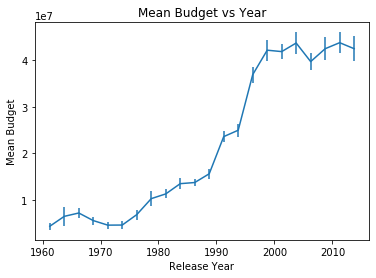

In [45]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['budget'].groupby(data_xbins).mean()
y_std = tmdbby['budget'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Budget');
plt.title('Mean Budget vs Year');

<h6>The mean budget seems to be increasing linearly with year</h6>

<h6>Popularity vs Year</h6>

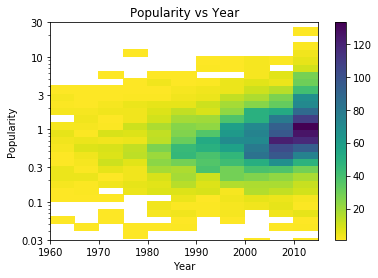

In [46]:
tmdbpr = tmdb.copy()
xbins  = np.arange(1960,tmdbpr['release_year'].max()+5,5)
ybins  = 10 ** np.arange(-3,1.4+0.1,0.1)
yticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'release_year', y = 'popularity',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 0.03)
plt.xticks(rotation = 0)
plt.xlabel('Year')
plt.ylabel('Popularity') 
plt.title('Popularity vs Year');

<h6>Popularity is well dispersed over the years however count of movies having popularity between 0.3 and 3 seems to have increased after 1990</h6>

<h6> Mean popularity vs years</h6>

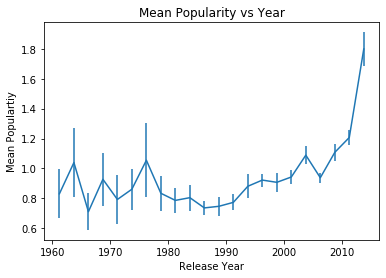

In [47]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['popularity'].groupby(data_xbins).mean()
y_std = tmdbby['popularity'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Populartiy');
plt.title('Mean Popularity vs Year');

<h6>There seems to be no trend between mean popularity and release year with lot of variability,after 2005 popularity seem to suddenly spike up</h6>

<h6>Revenue vs Runtime </h6>

Text(0.5, 1.0, 'Runtime vs Revenue')

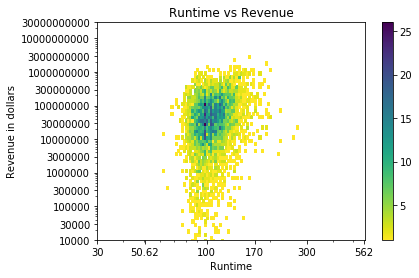

In [48]:
tmdbbr = tmdb.copy()
xbins  = 10 ** np.arange(1.16,2.78+0.01,0.01)
xticks = [0.01,0.017,0.03,0.0562,0.1,0.17,0.3,0.562,1,1.7,3,5.62,10,17,30,50.62,100,170,300,562,1000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbbr, x = 'runtime', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 30,xmax=570)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Runtime')
plt.ylabel('Revenue in dollars') 
plt.title('Runtime vs Revenue')

<h6>There doesn't seem to be any trend between runtime and revenue</h6>

In [49]:
tmdbpr = tmdb.copy()
tmdbpr['logrevenue'] = np.log10(tmdbpr['revenue'])
tmdbpr['logruntime'] = np.log10(tmdbpr['runtime'])
tmdbpr[['revenue','runtime','logrevenue','logruntime']].query('runtime>=49 & runtime <171 & revenue > 10000').corr()

,revenue,runtime,logrevenue,logruntime
revenue,1.000000,0.259541,0.624744,0.246762
runtime,0.259541,1.000000,0.251608,0.994714
logrevenue,0.624744,0.251608,1.000000,0.250194
logruntime,0.246762,0.994714,0.250194,1.000000


<h6>Correlation also suuggests there isn't any major relation between runtime and revenue</h6>

<h6>Budget vs Runtime</h6>

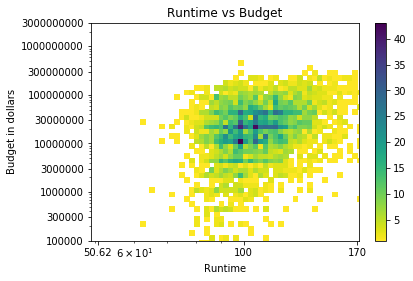

In [50]:
tmdbbr = tmdb.copy()
xbins  = 10 ** np.arange(1.16,2.78+0.01,0.01)
xticks = [0.01,0.017,0.03,0.0562,0.1,0.17,0.3,0.562,1,1.7,3,5.62,10,17,30,50.62,100,170,300,562,1000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,9+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbbr, x = 'runtime', y = 'budget',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 49,xmax=171)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 100000)
plt.xlabel('Runtime');
plt.ylabel('Budget in dollars'); 
plt.title('Runtime vs Budget');

<h6>Scatter plot suggests there isn't any trend between runtime and budget </h6>

In [51]:
tmdbpr = tmdb.copy()
tmdbpr['logbudget'] = np.log10(tmdbpr['budget'])
tmdbpr['logruntime'] = np.log10(tmdbpr['runtime'])
tmdbpr[['budget','runtime','logbudget','logruntime']].query('runtime>=49 & runtime <171 & budget > 100000').corr()

,budget,runtime,logbudget,logruntime
budget,1.000000,0.274621,0.771901,0.264303
runtime,0.274621,1.000000,0.283629,0.994726
logbudget,0.771901,0.283629,1.000000,0.285035
logruntime,0.264303,0.994726,0.285035,1.000000


<h6>Correlation also doesn't indicate any kind of relationship between budget and runtime</h6>

<h6>Mean Runtime vs Years</h6>

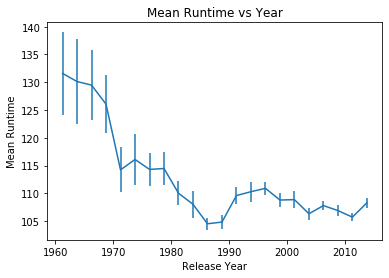

In [52]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['runtime'].groupby(data_xbins).mean()
y_std = tmdbby['runtime'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Runtime');
plt.title('Mean Runtime vs Year');

<h6>Runtime shows a negative trend with release year</h6>

<h6>Popularity vs RunTime</h6>

Text(0.5, 1.0, 'Runtime vs Popularity')

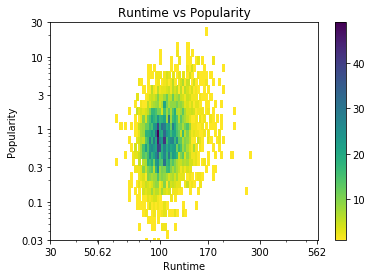

In [53]:
tmdbbr = tmdb.copy()
xbins  = 10 ** np.arange(1.16,2.78+0.01,0.01)
xticks = [0.01,0.017,0.03,0.0562,0.1,0.17,0.3,0.562,1,1.7,3,5.62,10,17,30,50.62,100,170,300,562,1000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(-3,1.4+0.1,0.1)
yticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbbr, x = 'runtime', y = 'popularity',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.xlim(xmin = 30,xmax=570)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 0.03)
plt.xlabel('Runtime')
plt.ylabel('Popularity') 
plt.title('Runtime vs Popularity')

<h6>Runtime and popularity shows no relationship,let's verify it with correlation</h6>

In [54]:
tmdbpr = tmdb.copy()
tmdbpr['logpopularity'] = np.log10(tmdbpr['popularity'])
tmdbpr['logruntime'] = np.log10(tmdbpr['runtime'])
tmdbpr[['popularity','runtime','logpopularity','logruntime']].query('runtime>=49 & runtime <171 & popularity > 0.03').corr()

,popularity,runtime,logpopularity,logruntime
popularity,1.000000,0.243210,0.800662,0.233084
runtime,0.243210,1.000000,0.216988,0.994742
logpopularity,0.800662,0.216988,1.000000,0.213528
logruntime,0.233084,0.994742,0.213528,1.000000


<h6>Correlation also doesn't indicate any kind of relationship between runtime and popularity</h6>

<h6>Revenue and votecount</h6>

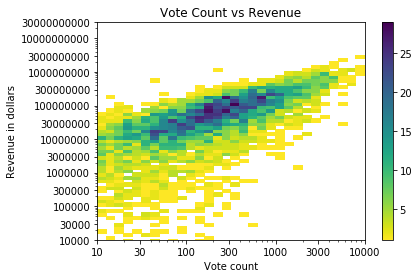

In [55]:
tmdbpr = tmdb.copy()
xbins  = 10 ** np.arange(1,3.99+0.1,0.1)
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_count', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Vote count')
plt.ylabel('Revenue in dollars') 
plt.title('Vote Count vs Revenue');

<h6>Vote count is showing a linear trend with revenue,even better than other variables we explored,let's verify it with correlation</h6>

In [56]:
tmdbpr = tmdb.copy()
tmdbpr['logrevenue'] = np.log10(tmdbpr['revenue'])
tmdbpr['logvote_count'] = np.log10(tmdbpr['vote_count'])
tmdbpr[['revenue','vote_count','logrevenue','logvote_count']].query('revenue> 10000').corr()

,revenue,vote_count,logrevenue,logvote_count
revenue,1.000000,0.755178,0.622607,0.604551
vote_count,0.755178,1.000000,0.489043,0.734173
logrevenue,0.622607,0.489043,1.000000,0.658114
logvote_count,0.604551,0.734173,0.658114,1.000000


<h6>Correlation also suggets a linear relationship of revenue with vote count</h6>

<h6>Vote count and budget</h6>

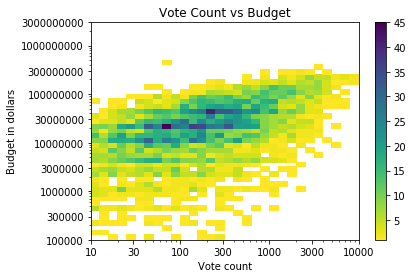

In [57]:
tmdbpr = tmdb.copy()
xbins  = 10 ** np.arange(1,3.99+0.1,0.1)
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(0,9+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_count', y = 'budget',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 100000)
plt.xlabel('Vote count')
plt.ylabel('Budget in dollars') 
plt.title('Vote Count vs Budget');

<h6>Budget and vote count also has a moderate linear relationship between them,let's look at correlation</h6>

In [58]:
tmdbpr = tmdb.copy()
tmdbpr['logbudget'] = np.log10(tmdbpr['budget'])
tmdbpr['logvote_count'] = np.log10(tmdbpr['vote_count'])
tmdbpr[['budget','vote_count','logbudget','logvote_count']].query('budget> 100000').corr()

,budget,vote_count,logbudget,logvote_count
budget,1.000000,0.554766,0.772649,0.524642
vote_count,0.554766,1.000000,0.386452,0.734309
logbudget,0.772649,0.386452,1.000000,0.488544
logvote_count,0.524642,0.734309,0.488544,1.000000


<h6>Correlation also suggests a linear trend between budget and votecount</h6>

<h6>Vote count and Popularity</h6>

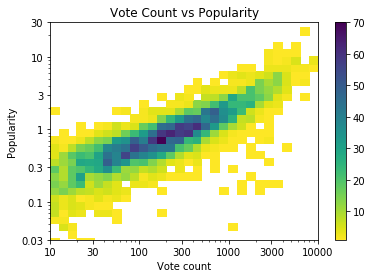

In [59]:
tmdbpr = tmdb.copy()
xbins  = 10 ** np.arange(1,3.99+0.1,0.1)
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
ybins  = 10 ** np.arange(-3,1.4+0.1,0.1)
yticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_count', y = 'popularity',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xscale('log');
plt.xticks(xticks, xlabels)
plt.xticks(rotation = 0)
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 0.03)
plt.xlabel('Vote count')
plt.ylabel('Popularity') 
plt.title('Vote Count vs Popularity');

<h6>Strongest linear trend that we have seen so far in this analysis,which suggests movies with higher vote count are usually popular</h6>

In [60]:
tmdbpr = tmdb.copy()
tmdbpr['logpopularity'] = np.log10(tmdbpr['popularity'])
tmdbpr['logvote_count'] = np.log10(tmdbpr['vote_count'])
tmdbpr[['popularity','vote_count','logpopularity','logvote_count']].query('popularity > 0.03').corr()

,popularity,vote_count,logpopularity,logvote_count
popularity,1.000000,0.821254,0.801435,0.690388
vote_count,0.821254,1.000000,0.659211,0.734080
logpopularity,0.801435,0.659211,1.000000,0.841824
logvote_count,0.690388,0.734080,0.841824,1.000000


<h6>Correlation also suggest a strong linear trend between popularity and vote count</h6>

<h6>Mean vote count vs years</h6>

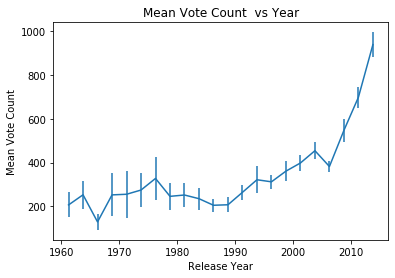

In [61]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['vote_count'].groupby(data_xbins).mean()
y_std = tmdbby['vote_count'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Vote Count');
plt.title('Mean Vote Count  vs Year');

<h6>Vote count is increasing over the years,with a large spike after 2006</h6>

<h6>Vote avg and Revenue</h6>

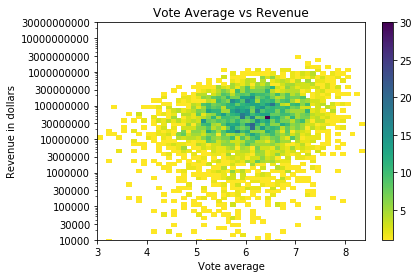

In [62]:
tmdbpr = tmdb.copy()
xbins  = np.arange(2,tmdb['vote_average'].max()+0.1,0.1)
ybins  = 10 ** np.arange(0,10+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_average', y = 'revenue',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.xlim(xmin=3);
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 10000)
plt.xlabel('Vote average')
plt.ylabel('Revenue in dollars') 
plt.title('Vote Average vs Revenue');

<h6>There isn't any significant trend between revenue and voteaverage according to heat map,let's check correlation</h6>

In [63]:
tmdbpr = tmdb.copy()
tmdbpr['logrevenue'] = np.log10(tmdbpr['revenue'])
tmdbpr[['revenue','vote_average','logrevenue']].query('vote_average>3 &revenue> 10000').corr()

,revenue,vote_average,logrevenue
revenue,1.000000,0.222332,0.622896
vote_average,0.222332,1.000000,0.197414
logrevenue,0.622896,0.197414,1.000000


<h6>Vote count and vote average</h6>

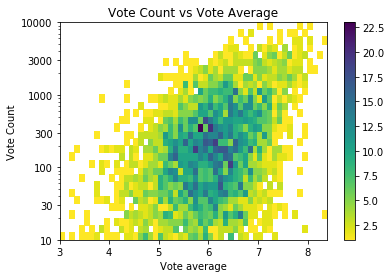

In [64]:
tmdbpr = tmdb.copy()
xbins  = np.arange(2,tmdb['vote_average'].max()+0.1,0.1)
ybins  = 10 ** np.arange(1,3.99+0.1,0.1)
yticks = [10, 30, 100, 300, 1000,3000,10000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_average', y = 'vote_count',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.xlim(xmin=3);
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.xlabel('Vote average')
plt.ylabel('Vote Count') 
plt.title('Vote Count vs Vote Average');

<h6>There seems to be weak linear trend between vote average and vote count</h6>

In [65]:
tmdbpr = tmdb.copy()
tmdbpr['logvote_count'] = np.log10(tmdbpr['vote_count'])
tmdbpr[['vote_count','vote_average','logvote_count']].query('vote_average>3').corr()

,vote_count,vote_average,logvote_count
vote_count,1.000000,0.376936,0.733478
vote_average,0.376936,1.000000,0.403074
logvote_count,0.733478,0.403074,1.000000


<h6>Correlation also suggests weak relation between vote average and vote count</h6>

<h6>Vote count and Budget</h6>

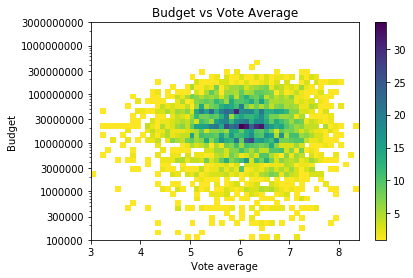

In [66]:
tmdbpr = tmdb.copy()
xbins  = np.arange(2,tmdb['vote_average'].max()+0.1,0.1)
ybins  = 10 ** np.arange(0,9+0.1,0.1)
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_average', y = 'budget',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.xlim(xmin=3);
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 100000)
plt.xlabel('Vote average')
plt.ylabel('Budget') 
plt.title('Budget vs Vote Average');

<h6>No Trend between budget and vote average as well </h6>

In [67]:
tmdbpr = tmdb.copy()
tmdbpr['logbudget'] = np.log10(tmdbpr['budget'])
tmdbpr[['budget','vote_average','logbudget']].query('vote_average>3 & budget>100000').corr()

,budget,vote_average,logbudget
budget,1.000000,0.026445,0.772611
vote_average,0.026445,1.000000,-0.039063
logbudget,0.772611,-0.039063,1.000000


<h6>Correlation also suggests weak trend between vote average and budget</h6>

<h6>Vote average and popularity</h6>

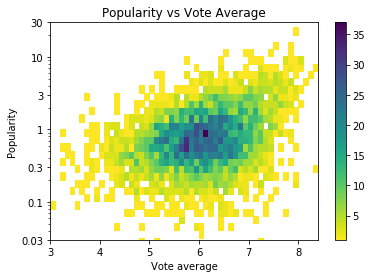

In [68]:
tmdbpr = tmdb.copy()
xbins  = np.arange(2,tmdb['vote_average'].max()+0.1,0.1)
ybins  = 10 ** np.arange(-3,1.4+0.1,0.1)
yticks = [0.01,0.03,0.1, 0.3, 1, 3, 10, 30]
ylabels = ['{}'.format(val) for val in yticks]
plt.hist2d(data = tmdbpr, x = 'vote_average', y = 'popularity',bins = [xbins, ybins], cmap = 'viridis_r', cmin = 0.5);
plt.colorbar()
plt.xticks(rotation = 0)
plt.xlim(xmin=3);
plt.yscale('log');
plt.yticks(yticks, ylabels)
plt.ylim(ymin = 0.03)
plt.xlabel('Vote average')
plt.ylabel('Popularity') 
plt.title('Popularity vs Vote Average');

<h6>There is weak average between vote average and popularity</h6>

In [69]:
tmdbpr = tmdb.copy()
tmdbpr['logpopularity'] = np.log10(tmdbpr['popularity'])
tmdbpr[['popularity','vote_average','logpopularity']].query('vote_average>3 & popularity>0.03').corr()

,popularity,vote_average,logpopularity
popularity,1.000000,0.344317,0.801711
vote_average,0.344317,1.000000,0.331400
logpopularity,0.801711,0.331400,1.000000


<h6>Mean vote average vs popularity</h6>

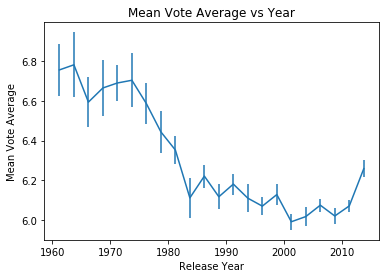

In [70]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges + 2.5/2)[:-1]
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['vote_average'].groupby(data_xbins).mean()
y_std = tmdbby['vote_average'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Vote Average');
plt.title('Mean Vote Average vs Year');

<h6>Surprisingly vote average is decreasing over the years</h6>

<h6>Genre and Revenue</h6>

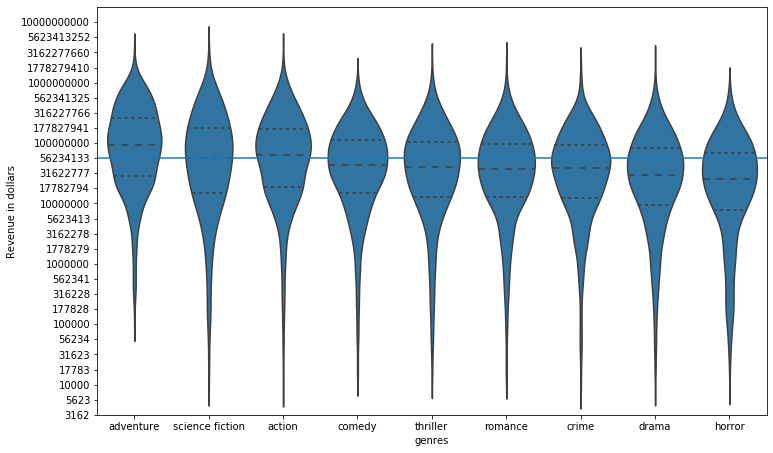

In [71]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
tmdbgenres['logrevenue'] = np.log10(tmdbgenres['revenue'])
fig = plt.figure(figsize=(12,7.5))
yticks = np.arange(0,10+0.25,0.25)
ylabels = ['{:0.0f}'.format(10 ** val) for val in yticks]
result = tmdbgenres.groupby(["genres"])['revenue'].aggregate(np.mean).reset_index().sort_values('revenue', ascending=False)
base_color = sb.color_palette()[0]
gh = sb.violinplot(data = tmdbgenres.query('revenue > 10000'), x = 'genres', y = 'logrevenue', \
                   color = base_color,inner = 'quartile',order= result['genres']);
plt.yticks(yticks, ylabels);
plt.ylim(ymin=3.5);
# gh.axhline(8)
gh.axhline(7.75)
# gh.axhline(7.5)
plt.ylabel('Revenue in dollars');

<h6>All violin plots tend to be unimodal in nature,adventure has the highest median revenue around 1e8(100 million) followed by action and science fiction,while horror has the lowest median revenue less than 30 million</h6>

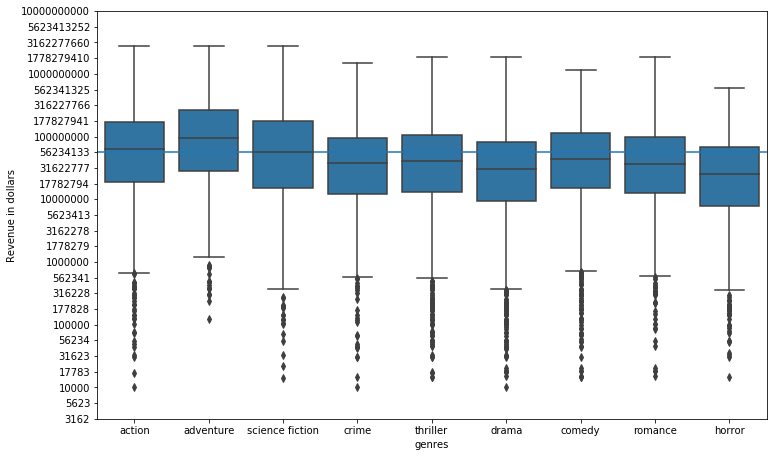

In [72]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
tmdbgenres['logrevenue'] = np.log10(tmdbgenres['revenue'])
fig = plt.figure(figsize=(12,7.5))
yticks = np.arange(0,10+0.25,0.25)
ylabels = ['{:0.0f}'.format(10 ** val) for val in yticks]
base_color = sb.color_palette()[0]
gh = sb.boxplot(data = tmdbgenres.query('revenue > 10000'), x = 'genres', y = 'logrevenue', color = base_color);
plt.yticks(yticks, ylabels);
plt.ylim(ymin=3.5);
gh.axhline(7.75)
plt.ylabel('Revenue in dollars');

<h6>Box posts also suggest the same thing as violin plot</h6>

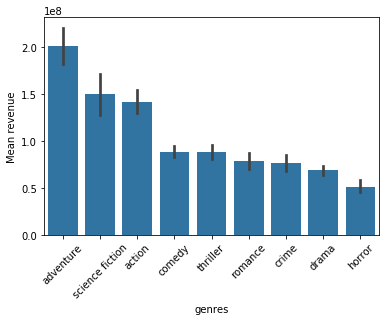

In [73]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
result = tmdbgenres.groupby(["genres"])['revenue'].aggregate(np.mean).reset_index().sort_values('revenue', ascending=False)
base_color = sb.color_palette()[0]
sb.barplot(data = tmdbgenres, x = 'genres', y = 'revenue', color = base_color,order= result['genres']);
plt.xticks(rotation=45);
plt.ylabel('Mean revenue');

<h6>Adventure seems to have the highest mean revenue around 200 million followed by science fiction and action,while horror has the least mean revenue around 50 million</h6>

<Figure size 11520x540 with 0 Axes>

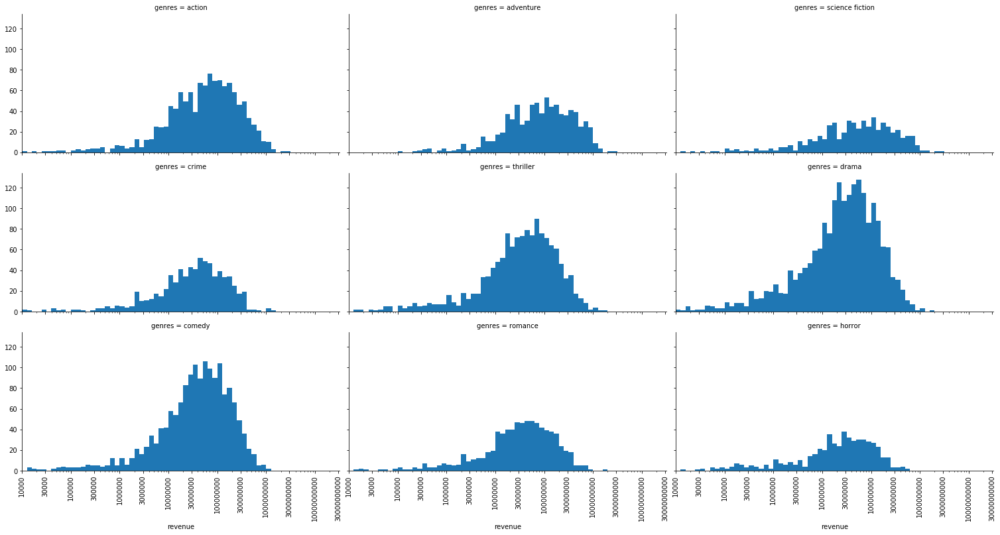

In [74]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
fig = plt.figure(figsize=(160,7.5))
bins  = 10 ** np.arange(0,10+0.1,0.1)
ticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
labels = ['{}'.format(val) for val in ticks]
g = sb.FacetGrid(data = tmdbgenres, col = 'genres', col_wrap = 3,height=3.5,aspect=2)
g.map(plt.hist, "revenue", bins = bins).set(xscale = 'log');
g.set(xticks = ticks, xticklabels = labels);
g.set(xlim= (10000,None));
for axes in g.axes.flat:
    _ = axes.set_xticklabels(axes.get_xticklabels(), rotation=90);

<h6>From the distribution count of drama movies is more,but it has a long tail of small revenue due to which it's median is lower,on the other hand adventure doesn't have a long tail so it's median is higher</h6>

<h6>Genre and Budget</h6>

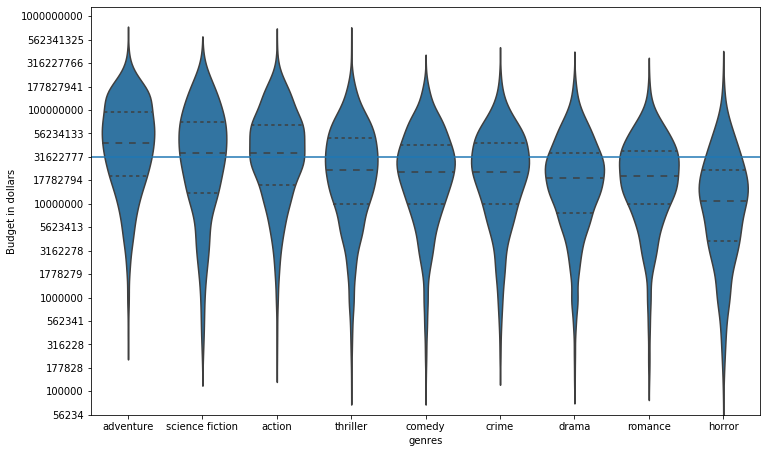

In [75]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
tmdbgenres['logbudget'] = np.log10(tmdbgenres['budget'])
fig = plt.figure(figsize=(12,7.5))
yticks = np.arange(0,9+0.25,0.25)
ylabels = ['{:0.0f}'.format(10 ** val) for val in yticks]
result = tmdbgenres.groupby(["genres"])['budget'].aggregate(np.mean).reset_index().sort_values('budget', ascending=False)
base_color = sb.color_palette()[0]
gh = sb.violinplot(data = tmdbgenres.query('budget > 100000'), x = 'genres', y = 'logbudget', \
                   color = base_color,inner = 'quartile',order= result['genres']);
plt.yticks(yticks, ylabels);
gh.axhline(7.5);
plt.ylim(ymin=4.75);
plt.ylabel('Budget in dollars');

<h6>Adventure seems to have the highest median budget(around 30 mil) as well followed by science fiction and action,while horror has the least median budget.All plots are unimodal here as well</h6>

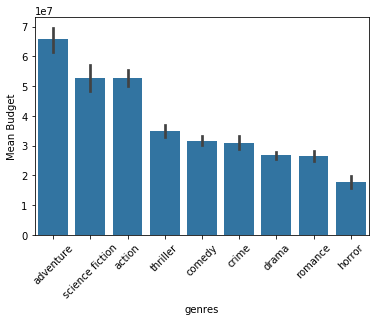

In [76]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
result = tmdbgenres.groupby(["genres"])['budget'].aggregate(np.mean).reset_index().sort_values('budget', ascending=False)
base_color = sb.color_palette()[0]
sb.barplot(data = tmdbgenres, x = 'genres', y = 'budget', color = base_color,order= result['genres']);
plt.xticks(rotation=45);
plt.ylabel('Mean Budget');

<h6>Same order is followed for mean budget as well,although adventure and science fiction seems to have higher variance</h6>

<Figure size 11520x540 with 0 Axes>

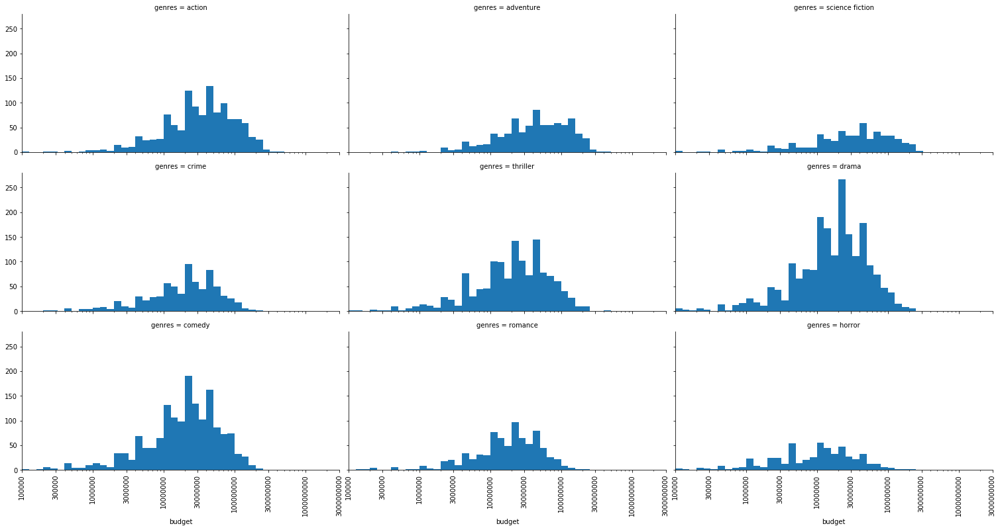

In [77]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
fig = plt.figure(figsize=(160,7.5))
bins  = 10 ** np.arange(0,9+0.1,0.1)
ticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
labels = ['{}'.format(val) for val in ticks]
g = sb.FacetGrid(data = tmdbgenres, col = 'genres', col_wrap = 3,height=3.5,aspect=2)
g.map(plt.hist, "budget", bins = bins).set(xscale = 'log');
g.set(xticks = ticks, xticklabels = labels);
g.set(xlim= (100000,None));
for axes in g.axes.flat:
    _ = axes.set_xticklabels(axes.get_xticklabels(), rotation=90);

<h6>Count of movies having drama genre is high is but the distribution for budget has a long tail towards lower budget,due to which median of budget is lower than of adventure,action and science fiction</h6>

<h6>Genre and Popularity</h6>

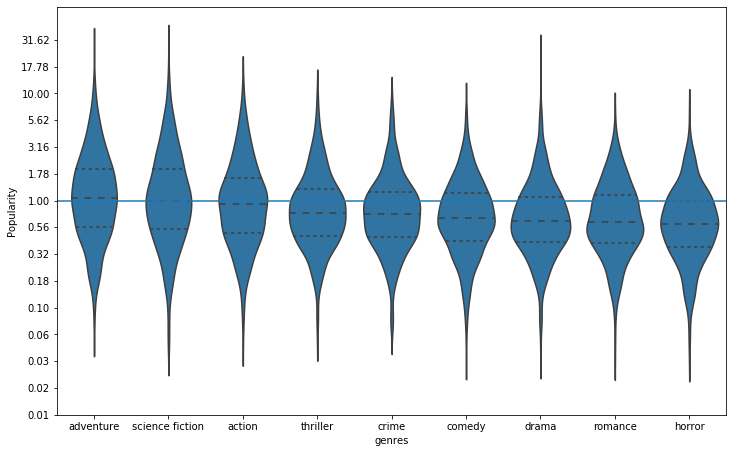

In [78]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
tmdbgenres['logpopularity'] = np.log10(tmdbgenres['popularity'])
fig = plt.figure(figsize=(12,7.5))
yticks = np.arange(-3,1.4+0.25,0.25)
ylabels = ['{:0.2f}'.format(10 ** val) for val in yticks]
result = tmdbgenres.groupby(["genres"])['popularity'].aggregate(np.mean).reset_index().sort_values('popularity', ascending=False)
base_color = sb.color_palette()[0]
gh = sb.violinplot(data = tmdbgenres.query('popularity > 0.03'), x = 'genres', y = 'logpopularity', \
                   color = base_color,inner = 'quartile',order= result['genres']);
plt.yticks(yticks, ylabels);
plt.ylim(ymin=-2);
gh.axhline(0)
#gh.axhline(7.75)
# gh.axhline(7.5)
plt.ylabel('Popularity');

<h6>Surprisingly same order is followed for popularity as well,adventure has highest median popularity,followed by science fiction and action,while horror has the least median popularity</h6>

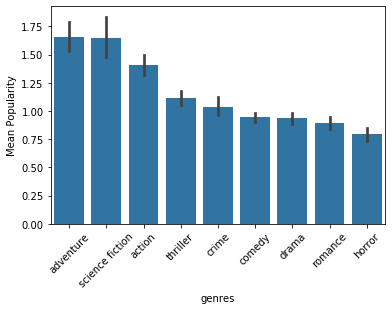

In [79]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
result = tmdbgenres.groupby(["genres"])['popularity'].aggregate(np.mean).reset_index().sort_values('popularity', ascending=False)
base_color = sb.color_palette()[0]
sb.barplot(data = tmdbgenres, x = 'genres', y = 'popularity', color = base_color,order= result['genres']);
plt.xticks(rotation=45);
plt.ylabel('Mean Popularity');

<h6>Same order is followed for mean popularity as well</h6>

<h6>Genre and Vote Count</h6>

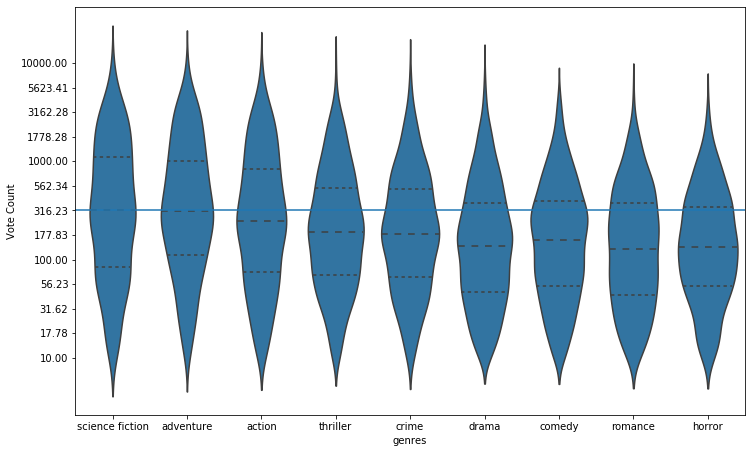

In [80]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
tmdbgenres['logvote_count'] = np.log10(tmdbgenres['vote_count'])
fig = plt.figure(figsize=(12,7.5))
yticks = np.arange(1,3.99+0.25,0.25)
ylabels = ['{:0.2f}'.format(10 ** val) for val in yticks]
result = tmdbgenres.groupby(["genres"])['vote_count'].aggregate(np.mean).reset_index().sort_values('vote_count', ascending=False)
base_color = sb.color_palette()[0]
gh = sb.violinplot(data = tmdbgenres, x = 'genres', y = 'logvote_count', \
                   color = base_color,inner = 'quartile',order= result['genres']);
plt.yticks(yticks, ylabels);
gh.axhline(2.5)
#gh.axhline(7.75)
# gh.axhline(7.5)
plt.ylabel('Vote Count');

<h6>Science fiction has highest median vote count(around 316) followed by adventure and action,while horror has the lowest median vote count(around 177).All plots are unimodal in nature.</h6>

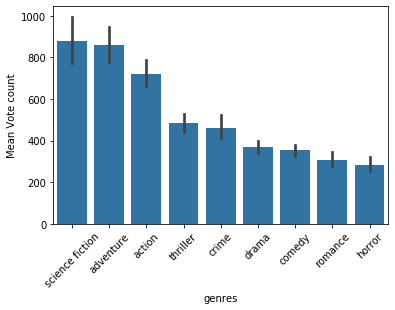

In [81]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
result = tmdbgenres.groupby(["genres"])['vote_count'].aggregate(np.mean).reset_index().sort_values('vote_count', ascending=False)
base_color = sb.color_palette()[0]
sb.barplot(data = tmdbgenres, x = 'genres', y = 'vote_count', color = base_color,order= result['genres']);
plt.xticks(rotation=45);
plt.ylabel('Mean Vote count');

<h6>Same order is followed for mean vote count as well</h6>

Bivariate analysis conclusion:<br>
(1)Log budget and log revenue seems to be linearly correlated with each other,however corr showed normal budget and revenue are correlated as well(need to check in regression)<br>
(2)Log popularity and log revenue seems to be linearly correlated with each other,however corr showed normal popularity and revenue are correlated as well(need to check in regression)<br>
(3)Log popularity and log budget are also moderately correlated<br>
(4)Line plot of revenue vs year show revenue has increase over a period of 1960 to 2015 with exception of dip between 1980 and 1990<br>
(5)Budget has increased linearly over period of time,however after 1995,it hasn't changed much<br>
(6)There seems to be no trend between mean popularity and release year with lot of variability,after 2005 popularity seem to suddenly spike up<br>
(7)Runtime of movies have decreased over period of time<br>
(8)Log Revenue is linearly correlated with log vote count than any other variable,normal revenue and vote count seems to be correlated as well(check in regression)<br>
(8)Log budget and log vote count are also moderately correalated<br>
(9)Log Popularity of movie and log vote count showed the best correlation than any other combination suggesting that movies with more vote count are usually popular<br>
(10)Vote count was steadily increasing over the years,however it spiked up after 2006<br>
(11)Vote average ratings have suprisingly decreased over the years<br>
(12)Genres of adventure,science fiction and action tend to have higher budget,revenue,popularity and vote count while horror genre had the least median budget,revenue,popularity and votecount<br>

<h5>Multivariate Visualization</h5>

<h6>Budget,vote count and revenue</h6>

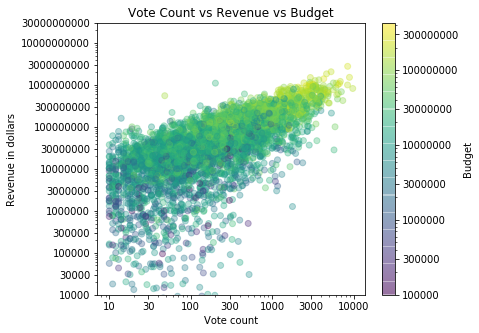

In [82]:
tmdbbr =tmdb.copy()
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
cticks = [100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
clabels = ['{}'.format(val) for val in xticks]
fig = plt.figure(figsize=(6,5))
plt.scatter(data = tmdbbr.query('budget>= 100000'), x = 'vote_count', y = 'revenue', c = 'budget',cmap = 'viridis' \
           ,norm=matcolor.LogNorm(),alpha=1/3);
cbar = plt.colorbar(label='Budget')
plt.xscale('log');
plt.yscale('log');
plt.xticks(xticks, xlabels);
plt.yticks(yticks, ylabels);
plt.xticks(rotation = 0);
plt.ylim(ymin = 10000);
cbar.set_ticks([100000,300000,1000000,3000000,10000000,30000000,100000000,300000000]);
cbar.set_ticklabels([100000,300000,1000000,3000000,10000000,30000000,100000000,300000000]);
plt.xlabel('Vote count');
plt.ylabel('Revenue in dollars');
plt.title('Vote Count vs Revenue vs Budget');

<h6>As one can see from the graph for lighter regions of the graph revenue is higher indicating that as budget increases revenue also increases,similary as vote count is increasing along x axis revenue seems to increase along with it.Also for darker color(lower budget) and lower vote count,revenue is fare less than the ones that have lighter color(higher budget) and higher vote count</h6>

<h6>Vote Count and Revenue and Popularity</h6>

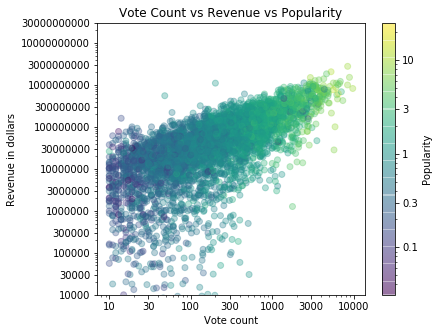

In [83]:
tmdbbr =tmdb.copy()
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
fig = plt.figure(figsize=(6,5))
plt.scatter(data = tmdbbr.query('popularity>= 0.03'), x = 'vote_count', y = 'revenue', c = 'popularity',cmap = 'viridis' \
           ,norm=matcolor.LogNorm(),alpha=1/3);
cbar = plt.colorbar(label='Popularity')
plt.xscale('log');
plt.yscale('log');
plt.xticks(xticks, xlabels);
plt.yticks(yticks, ylabels);
plt.xticks(rotation = 0);
plt.ylim(ymin = 10000);
cbar.set_ticks([0.01,0.03,0.1,0.3,1,3,10,30]);
cbar.set_ticklabels([0.01,0.03,0.1,0.3,1,3,10,30]);
plt.xlabel('Vote count');
plt.ylabel('Revenue in dollars');
plt.title('Vote Count vs Revenue vs Popularity');

<h6>One can clearly see that regions having dark color(lower popularity) and lower votecount has revenue which is far less than the regions having lighter color(higher popularity) and higher votecount.The difference is in multiples of 10.</h6>

<h6>Revenue and Budget and Popularity</h6>

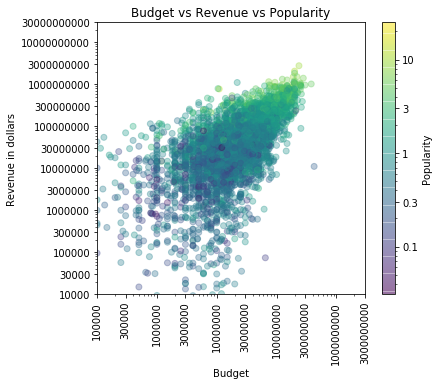

In [84]:
tmdbbr =tmdb.copy()
xticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [0.1, 0.3, 1, 3, 10, 30, 100, 300, 1000,3000,10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
fig = plt.figure(figsize=(6,5))
plt.scatter(data = tmdbbr.query('popularity>= 0.03'), x = 'budget', y = 'revenue', c = 'popularity',cmap = 'viridis' \
           ,norm=matcolor.LogNorm(),alpha=1/3);
cbar = plt.colorbar(label='Popularity')
plt.xscale('log');
plt.yscale('log');
plt.xticks(xticks, xlabels);
plt.yticks(yticks, ylabels);
plt.xticks(rotation = 90);
plt.ylim(ymin = 10000);
plt.xlim(xmin = 100000);
cbar.set_ticks([0.01,0.03,0.1,0.3,1,3,10,30]);
cbar.set_ticklabels([0.01,0.03,0.1,0.3,1,3,10,30]);
plt.xlabel('Budget');
plt.ylabel('Revenue in dollars');
plt.title('Budget vs Revenue vs Popularity');

<h6>One can clearly see that regions having dark color(lower popularity) and lower budget has revenue which is far less than the regions having lighter color(higher popularity) and higher budget.The difference is in multiples of 10.</h6>

<h6>Vote count and revenue and genre</h6>

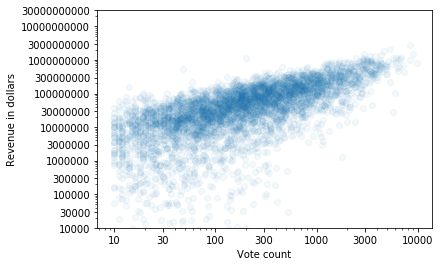

In [85]:
tmdbbr =tmdb.copy()
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
sb.regplot(data = tmdbbr, x = 'vote_count', y = 'revenue', scatter_kws = {'alpha' : 1/20},fit_reg = False)
plt.xscale('log');
plt.yscale('log');
plt.ylim(ymin = 10000);
plt.xticks(xticks, xlabels);
plt.yticks(yticks, ylabels);
plt.xlabel('Vote count');
plt.ylabel('Revenue in dollars');

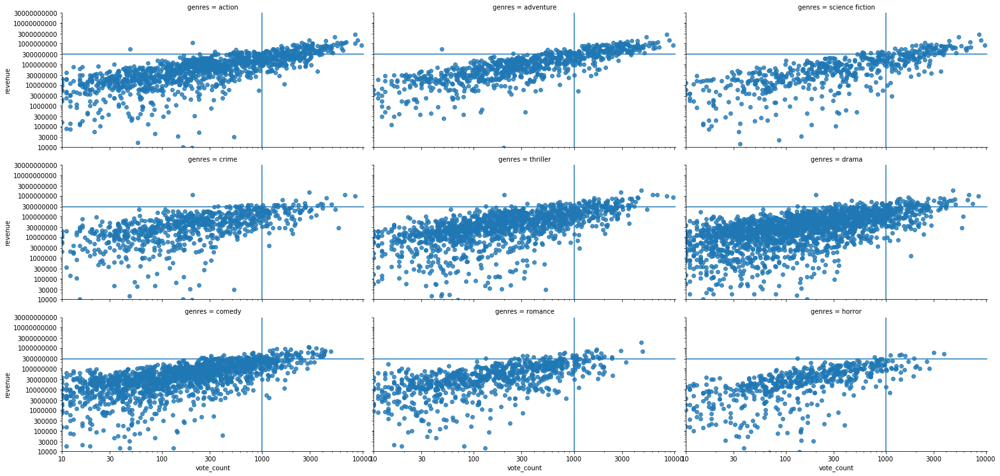

In [86]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
g = sb.FacetGrid(data = tmdbgenres, col = 'genres', col_wrap = 3,height=3.5,aspect=2);
g.map(sb.regplot,'vote_count', 'revenue',fit_reg = False).set(xscale = 'log');
g.set(yscale = 'log');
g.set(xticks = xticks, xticklabels = xlabels);
g.set(yticks = yticks, yticklabels = ylabels);
g.set(ylim= (10000,None));
for a in g.axes:
    a.axhline(300000000);
for a in g.axes:
    a.axvline(1000);

<h6>From the plot movies of genre action and adventure seems to have the strongest linear relationship between vote count and revenue,while crime,horror and drama seems to have the weakest linear relationship.Also action and adventure seems to have higher number of movies that have high vote count and revenue than any other genre</h6>

In [87]:
tmdbgenres[['vote_count','revenue','genres']].groupby('genres').corr()

vote_count   revenue
genres                                          
action          vote_count    1.000000  0.798739
                revenue       0.798739  1.000000
adventure       vote_count    1.000000  0.819273
                revenue       0.819273  1.000000
comedy          vote_count    1.000000  0.723796
                revenue       0.723796  1.000000
crime           vote_count    1.000000  0.628775
                revenue       0.628775  1.000000
drama           vote_count    1.000000  0.658643
                revenue       0.658643  1.000000
horror          vote_count    1.000000  0.697995
                revenue       0.697995  1.000000
romance         vote_count    1.000000  0.692869
                revenue       0.692869  1.000000
science fiction vote_count    1.000000  0.804558
                revenue       0.804558  1.000000
thriller        vote_count    1.000000  0.707744
                revenue       0.707744  1.000000

<h6>We can confirm above facts from correlation as well</h6>

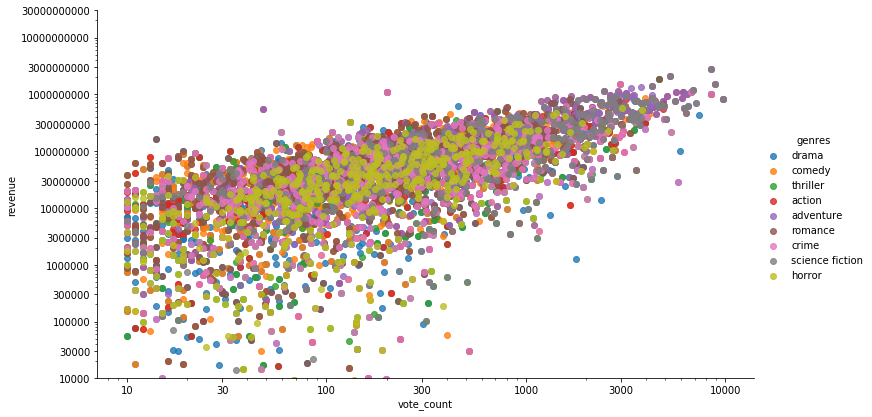

In [88]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xticks = [10, 30, 100, 300, 1000,3000,10000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres',hue_order=['drama','comedy','thriller','action', \
                                                              'adventure','romance','crime','science fiction','horror']);
g.fig.set_figheight(6);
g.fig.set_figwidth(10);
g.map(sb.regplot,'vote_count', 'revenue',fit_reg = False).set(xscale = 'log');
g.set(yscale = 'log');
g.set(xticks = xticks, xticklabels = xlabels);
g.set(yticks = yticks, yticklabels = ylabels);
g.set(ylim= (10000,None));
g.add_legend();

<h6>Budget and revenue and genre</h6>

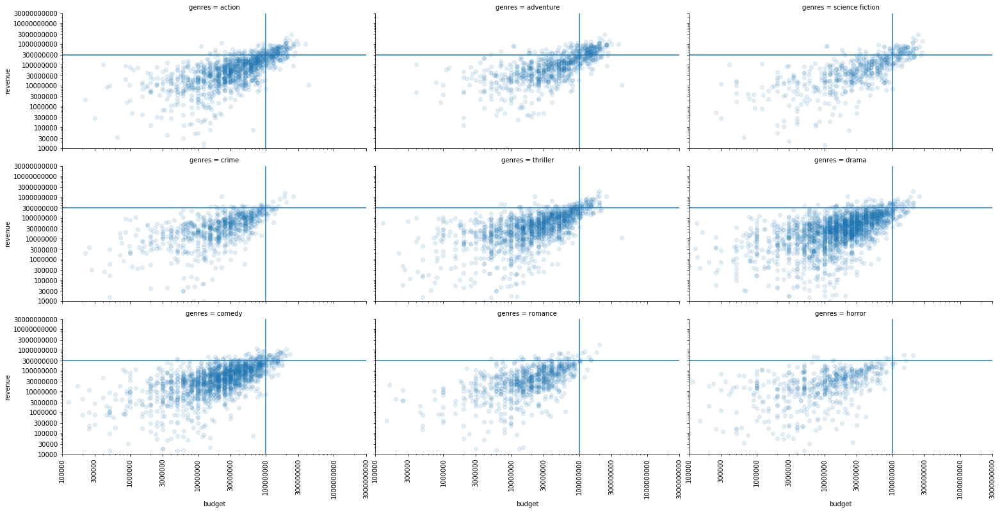

In [89]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xticks = [100000,300000,1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
g = sb.FacetGrid(data = tmdbgenres, col = 'genres', col_wrap = 3,height=3.5,aspect=2);
g.map(sb.regplot,'budget', 'revenue',fit_reg = False, scatter_kws = {'alpha' : 1/8}).set(xscale = 'log');
g.set(yscale = 'log');
g.set(xticks = xticks, xticklabels = xlabels);
g.set(yticks = yticks, yticklabels = ylabels);
g.set(ylim= (10000,None),xlim= (100000,None));
for axes in g.axes.flat:
    _ = axes.set_xticklabels(axes.get_xticklabels(), rotation=90);
    axes.axhline(300000000);
    axes.axvline(100000000);

<h6>Action and adventure seems to have the strongest linear relationship between budget and revenue,while horror and romance seems to have the worst linear relationship.It is evident from below correlation as well.Also action and adventure seems to have  higher count of higher budget and higher revenue movies than any other genre </h6>

In [90]:
tmdbgenres[['budget','revenue','genres']].groupby('genres').corr()

budget   revenue
genres                                     
action          budget   1.000000  0.691878
                revenue  0.691878  1.000000
adventure       budget   1.000000  0.668115
                revenue  0.668115  1.000000
comedy          budget   1.000000  0.644918
                revenue  0.644918  1.000000
crime           budget   1.000000  0.671742
                revenue  0.671742  1.000000
drama           budget   1.000000  0.606614
                revenue  0.606614  1.000000
horror          budget   1.000000  0.602194
                revenue  0.602194  1.000000
romance         budget   1.000000  0.591852
                revenue  0.591852  1.000000
science fiction budget   1.000000  0.689037
                revenue  0.689037  1.000000
thriller        budget   1.000000  0.667177
                revenue  0.667177  1.000000

<h6>Popularity and revenue and genre</h6>

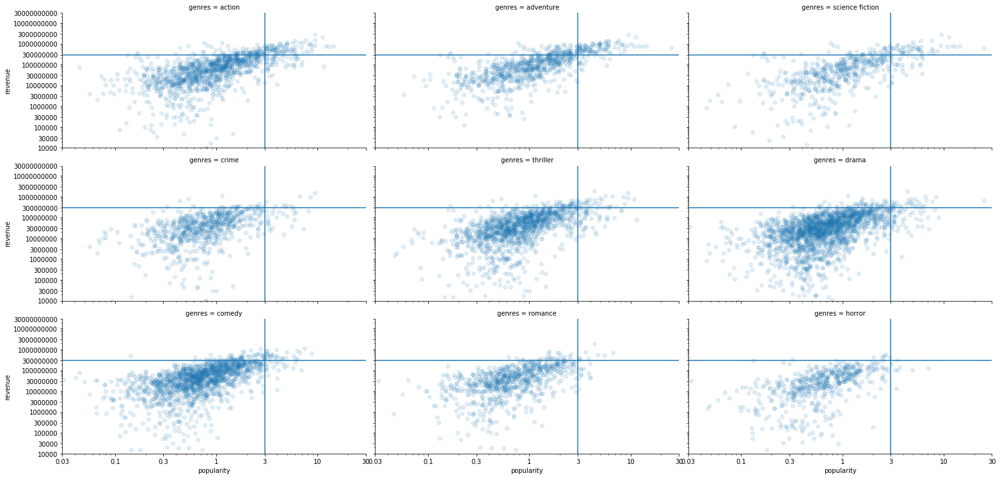

In [91]:
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xticks = [0.03,0.1, 0.3, 1, 3, 10, 30]
xlabels = ['{}'.format(val) for val in xticks]
yticks = [10000,30000,100000,300000, \
         1000000,3000000,10000000,30000000,100000000,300000000,1000000000,3000000000, \
        10000000000,30000000000]
ylabels = ['{}'.format(val) for val in yticks]
g = sb.FacetGrid(data = tmdbgenres, col = 'genres', col_wrap = 3,height=3.5,aspect=2);
g.map(sb.regplot,'popularity', 'revenue',fit_reg = False, scatter_kws = {'alpha' : 1/8}).set(xscale = 'log');
g.set(yscale = 'log');
g.set(xticks = xticks, xticklabels = xlabels);
g.set(yticks = yticks, yticklabels = ylabels);
g.set(ylim= (10000,None),xlim= (0.03,None));
for axes in g.axes.flat:
    axes.axhline(300000000);
    axes.axvline(3);

<h6>Action and adventure seems to have the strongest linear relationship between popularity and revenue,while horror and romance seems to have the worst linear relationship.It is evident from below correlation as well.Also action and adventure seems to have  higher count of higher popularity and higher revenue movies than any other genre </h6>

In [92]:
tmdbgenres[['popularity','revenue','genres']].groupby('genres').corr()

popularity   revenue
genres                                          
action          popularity    1.000000  0.681728
                revenue       0.681728  1.000000
adventure       popularity    1.000000  0.692301
                revenue       0.692301  1.000000
comedy          popularity    1.000000  0.650007
                revenue       0.650007  1.000000
crime           popularity    1.000000  0.552633
                revenue       0.552633  1.000000
drama           popularity    1.000000  0.527893
                revenue       0.527893  1.000000
horror          popularity    1.000000  0.530997
                revenue       0.530997  1.000000
romance         popularity    1.000000  0.578593
                revenue       0.578593  1.000000
science fiction popularity    1.000000  0.631881
                revenue       0.631881  1.000000
thriller        popularity    1.000000  0.593072
                revenue       0.593072  1.000000

<h6>Revenue and release year and genre</h6>

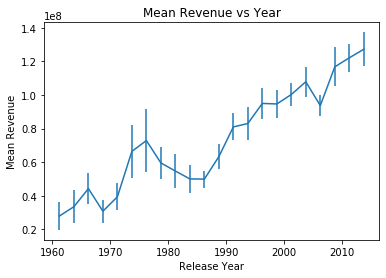

In [93]:
tmdbby = tmdb.copy()
xbin_edges = np.arange(1960,tmdbby['release_year'].max()+2.5, 2.5)
xbin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2
data_xbins = pd.cut(tmdbby['release_year'], xbin_edges, right = False, include_lowest = True)
y_means = tmdbby['revenue'].groupby(data_xbins).mean()
y_std = tmdbby['revenue'].groupby(data_xbins).sem()
plt.errorbar(x = xbin_centers, y = y_means, yerr = y_std);
plt.xlabel('Release Year');
plt.ylabel('Mean Revenue');
plt.title('Mean Revenue vs Year');

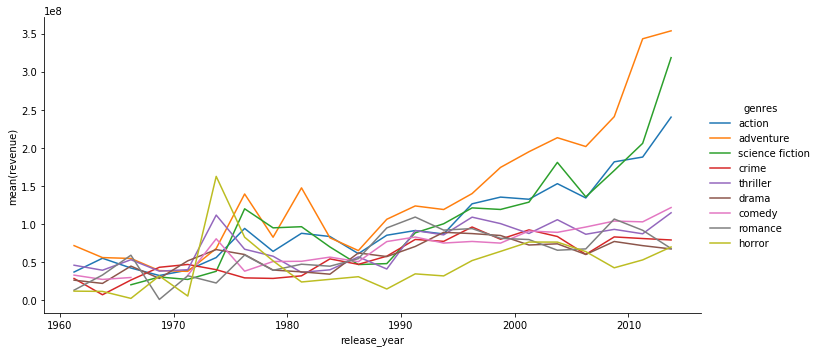

In [94]:
def mean_poly(x, y, bins = 10, **kwargs):
    """ Custom adapted line plot code. """
    # set bin edges if none or int specified
    if type(bins) == int:
        bins = np.linspace(x.min(), x.max(), bins+1)
    bin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2

    # compute counts
    data_bins = pd.cut(x, bins, right = False,
                       include_lowest = True)
    means = y.groupby(data_bins).mean()

    # create plot
    plt.errorbar(x = bin_centers, y = means, **kwargs)
    
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xbin_edges = np.arange(1960,tmdbgenres['release_year'].max()+2.5, 2.5)
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres')
g.fig.set_figheight(5);
g.fig.set_figwidth(10);
g.map(mean_poly, "release_year", "revenue", bins = xbin_edges)
g.set_ylabels('mean(revenue)')
g.add_legend();

<h6>Action,adventure and science fiction's mean revenue seems to be increasing at a higher rate than any other genre especially after 1990,while horrow has the least growth rate in terms of mean revenue over the years</h6>

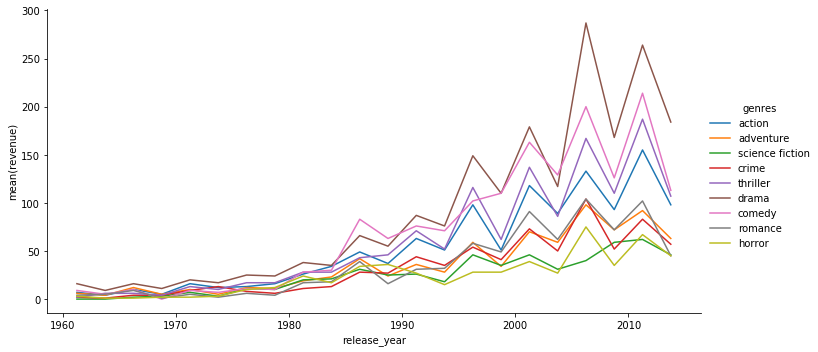

In [95]:
def mean_poly(x, y, bins = 10, **kwargs):
    """ Custom adapted line plot code. """
    # set bin edges if none or int specified
    if type(bins) == int:
        bins = np.linspace(x.min(), x.max(), bins+1)
    bin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2

    # compute counts
    data_bins = pd.cut(x, bins, right = False,
                       include_lowest = True)
    means = y.groupby(data_bins).count()

    # create plot
    plt.errorbar(x = bin_centers, y = means, **kwargs)
    
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xbin_edges = np.arange(1960,tmdbgenres['release_year'].max()+2.5, 2.5)
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres')
g.fig.set_figheight(5);
g.fig.set_figwidth(10);
g.map(mean_poly, "release_year", "revenue", bins = xbin_edges)
g.set_ylabels('mean(revenue)')
g.add_legend();

<h6>The order of count of movies genrewise is same over all the years,and movie count of all genres is increasing and decreasing at the same rate</h6>

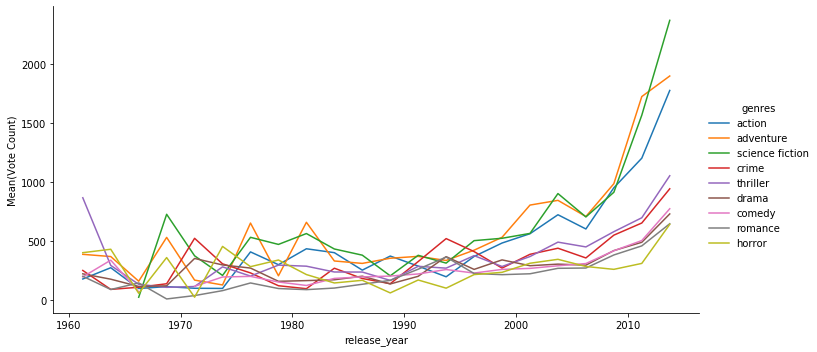

In [96]:
def mean_poly(x, y, bins = 10, **kwargs):
    """ Custom adapted line plot code. """
    # set bin edges if none or int specified
    if type(bins) == int:
        bins = np.linspace(x.min(), x.max(), bins+1)
    bin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2

    # compute counts
    data_bins = pd.cut(x, bins, right = False,
                       include_lowest = True)
    means = y.groupby(data_bins).mean()

    # create plot
    plt.errorbar(x = bin_centers, y = means, **kwargs)
    
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xbin_edges = np.arange(1960,tmdbgenres['release_year'].max()+2.5, 2.5)
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres')
g.fig.set_figheight(5);
g.fig.set_figwidth(10);
g.map(mean_poly, "release_year", "vote_count", bins = xbin_edges)
g.set_ylabels('Mean(Vote Count)')
g.add_legend();

<h6>Action,adventure and science fiction's mean vote count seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean vote count over the years</h6>

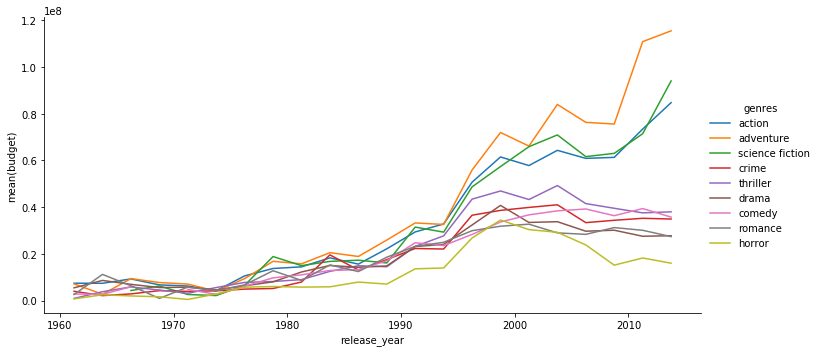

In [97]:
def mean_poly(x, y, bins = 10, **kwargs):
    """ Custom adapted line plot code. """
    # set bin edges if none or int specified
    if type(bins) == int:
        bins = np.linspace(x.min(), x.max(), bins+1)
    bin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2

    # compute counts
    data_bins = pd.cut(x, bins, right = False,
                       include_lowest = True)
    means = y.groupby(data_bins).mean()

    # create plot
    plt.errorbar(x = bin_centers, y = means, **kwargs)
    
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xbin_edges = np.arange(1960,tmdbgenres['release_year'].max()+2.5, 2.5)
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres')
g.fig.set_figheight(5);
g.fig.set_figwidth(10);
g.map(mean_poly, "release_year", "budget", bins = xbin_edges)
g.set_ylabels('mean(budget)')
g.add_legend();

<h6>Action,adventure and science fiction's mean budget seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean budget over the years</h6>

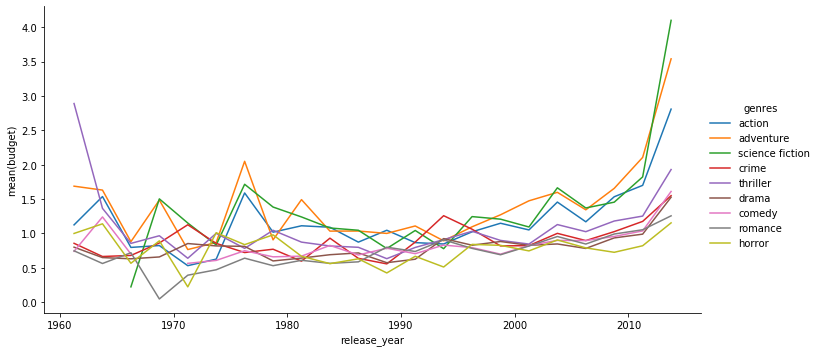

In [98]:
def mean_poly(x, y, bins = 10, **kwargs):
    """ Custom adapted line plot code. """
    # set bin edges if none or int specified
    if type(bins) == int:
        bins = np.linspace(x.min(), x.max(), bins+1)
    bin_centers = (xbin_edges[1:] + xbin_edges[:-1]) / 2

    # compute counts
    data_bins = pd.cut(x, bins, right = False,
                       include_lowest = True)
    means = y.groupby(data_bins).mean()

    # create plot
    plt.errorbar(x = bin_centers, y = means, **kwargs)
    
tmdbgenres = tmdb.copy()
tmdbgenres = tmdbgenres.assign(genres=tmdbgenres.genres.str.split('|')).explode('genres')
tmdbgenres = tmdbgenres[tmdbgenres['genres'].isin(['drama','comedy','thriller','action', \
                                                  'adventure','romance','crime','science fiction','horror'])]
xbin_edges = np.arange(1960,tmdbgenres['release_year'].max()+2.5, 2.5)
g = sb.FacetGrid(data = tmdbgenres, hue = 'genres')
g.fig.set_figheight(5);
g.fig.set_figwidth(10);
g.map(mean_poly, "release_year", "popularity", bins = xbin_edges)
g.set_ylabels('mean(budget)')
g.add_legend();

<h6>Action,adventure and science fiction's mean popularity seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean popularity over the years</h6>

Bivariate analysis conclusion:<br>
(1)Log budget and log revenue seems to be linearly correlated with each other,however corr showed normal budget and revenue are correlated as well(need to check in regression)<br>
(2)Log popularity and log revenue seems to be linearly correlated with each other,however corr showed normal popularity and revenue are correlated as well(need to check in regression)<br>
(3)Log popularity and log budget are also moderately correlated<br>
(4)Line plot of revenue vs year show revenue has increase over a period of 1960 to 2015 with exception of dip between 1980 and 1990<br>
(5)Budget has increased linearly over period of time,however after 1995,it hasn't changed much<br>
(6)There seems to be no trend between mean popularity and release year with lot of variability,after 2005 popularity seem to suddenly spike up<br>
(7)Runtime of movies have decreased over period of time<br>
(8)Log Revenue is linearly correlated with log vote count than any other variable,normal revenue and vote count seems to be correlated as well(check in regression)<br>
(8)Log budget and log vote count are also moderately correalated<br>
(9)Log Popularity of movie and log vote count showed the best correlation than any other combination suggesting that movies with more vote count are usually popular<br>
(10)Vote count was steadily increasing over the years,however it spiked up after 2006<br>
(11)Vote average ratings have suprisingly decreased over the years<br>
(12)Genres of adventure,science fiction and action tend to have higher budget,revenue,popularity and vote count while horror genre had the least median budget,revenue,popularity and votecount<br>
(13)Higher budget and higher vote count movies have usually higher revenue than the ones having low vote count and low budget.Need to check in regression if both budget and vote count together is able to predict revenue than considering only vote count or only budget<br>
(14)Higher popularity and higher vote count movies have usually higher revenue than the ones having low vote count and low popularity.Need to check in regression if both popuarity and vote count together is able to predict revenue than considering only vote count or only popularity<br>
(15)Higher budget and higher popularity movies have usually higher revenue than the ones having lowert budget and lower popularity.Need to check in regression if both budget and popularity together is able to predict revenue than considering only popularity or only budget<br>
(16)Movies of genre action and adventure seems to have the strongest linear relationship between vote count and revenue,while crime,horror and drama seems to have the weakest linear relationship.Also action and adventure seems to have higher number of movies that have high vote count and revenue than any other genre<br>
(17)Action and adventure seems to have the strongest linear relationship between budget and revenue,while horror and romance seems to have the worst linear relationship.It is evident from below correlation as well.Also action and adventure seems to have  higher count of higher budget and higher revenue movies than any other genre<br>
(18)Action and adventure seems to have the strongest linear relationship between popularity and revenue,while horror and drama seems to have the worst linear relationship.It is evident from below correlation as well.Also action and adventure seems to have  higher count of higher popularity and higher revenue movies than any other genre<br>
(19)Action,adventure and science fiction's mean revenue seems to be increasing at a higher rate than any other genre especially after 1990,while horrow has the least growth rate in terms of mean revenue over the years<br>
(20)The order of count of movies genrewise is same over all the years,and movie count of all genres is increasing and decreasing at the same rate<br>
(21)Action,adventure and science fiction's mean vote count seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean vote count over the years<br>
(22)Action,adventure and science fiction's mean budget seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean budget over the years<br>
(23)Action,adventure and science fiction's mean popularity seems to be increasing at a higher rate than any other genre especially after 1990,while horror has the least growth rate in terms of mean popularity over the years<br>

<h5>Regression</h5>

<h6>Estimation of revenue with vote count</h6>

In [112]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['vote_count','revenue']].query('revenue> 10000 & revenue <=3000000000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logvote_count'] = np.log10(tmdbreg['vote_count'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['revenue'], tmdbreg[['intercept', 'vote_count']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                revenue   R-squared:                       0.570
Model:                            OLS   Adj. R-squared:                  0.570
Method:                 Least Squares   F-statistic:                     5798.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:30:40   Log-Likelihood:                -87087.
No. Observations:                4371   AIC:                         1.742e+05
Df Residuals:                    4369   BIC:                         1.742e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   2.702e+07    1.9e+06     14.248      0.000    2.33e+07    3.07e+07
vote_count  1.515e+05   1989.945     76.147      0.000    1.48e+05    1.55e+05
==============================================================================
Omnibus:                     2792.201   Durbin-Watson:                   1.796
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           134579.974
Skew:                           2.407   Prob(JB):                         0.00
Kurtosis:                      29.754   Cond. No.                     1.10e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.1e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

<h6>Estimation of log revenue with log vote count</h6>

In [100]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['vote_count','revenue']].query('revenue> 10000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logvote_count'] = np.log10(tmdbreg['vote_count'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['logrevenue'], tmdbreg[['intercept', 'logvote_count']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             logrevenue   R-squared:                       0.433
Model:                            OLS   Adj. R-squared:                  0.433
Method:                 Least Squares   F-statistic:                     3338.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:11:32   Log-Likelihood:                -4075.7
No. Observations:                4371   AIC:                             8155.
Df Residuals:                    4369   BIC:                             8168.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
intercept         5.5737      0.035    161.315      0.000       5.506       5.641
logvote_count     0.8562      0.015     57.776      0.000       0.827       0.885
==============================================================================
Omnibus:                     1295.981   Durbin-Watson:                   1.723
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             4008.747
Skew:                          -1.518   Prob(JB):                         0.00
Kurtosis:                       6.578   Cond. No.                         10.2
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<h6>Revenue is best estimated by vote count,wherein linear regression accounts for 57% variability in revenue</h6>

<h6>Estimation of revenue with budget</h6>

In [101]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['budget','revenue']].query('budget>100000 & revenue > 10000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logbudget'] = np.log10(tmdbreg['budget'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['revenue'], tmdbreg[['intercept', 'budget']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                revenue   R-squared:                       0.473
Model:                            OLS   Adj. R-squared:                  0.473
Method:                 Least Squares   F-statistic:                     3896.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:11:32   Log-Likelihood:                -86942.
No. Observations:                4341   AIC:                         1.739e+05
Df Residuals:                    4339   BIC:                         1.739e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -1.308e+06   2.44e+06     -0.536      0.592   -6.09e+06    3.48e+06
budget         2.8386      0.045     62.419      0.000       2.749       2.928
==============================================================================
Omnibus:                     3774.898   Durbin-Watson:                   1.564
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           335608.339
Skew:                           3.697   Prob(JB):                         0.00
Kurtosis:                      45.436   Cond. No.                     7.15e+07
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.15e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

<h6>Estimation of log revenue with log budget</h6>

In [102]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['budget','revenue']].query('budget>100000 & revenue > 10000 & revenue <=3000000000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logbudget'] = np.log10(tmdbreg['budget'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['logrevenue'], tmdbreg[['intercept', 'logbudget']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             logrevenue   R-squared:                       0.369
Model:                            OLS   Adj. R-squared:                  0.369
Method:                 Least Squares   F-statistic:                     2540.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:11:32   Log-Likelihood:                -4243.4
No. Observations:                4341   AIC:                             8491.
Df Residuals:                    4339   BIC:                             8504.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.0240      0.129      7.941      0.000       0.771       1.277
logbudget      0.8903      0.018     50.400      0.000       0.856       0.925
==============================================================================
Omnibus:                      885.261   Durbin-Watson:                   1.585
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2342.815
Skew:                          -1.093   Prob(JB):                         0.00
Kurtosis:                       5.858   Cond. No.                         98.2
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<h6>Revenue estimated by budget accounts for 47% variability in data</h6>

<h6>Estimation of revenue with popularity</h6>

In [103]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['popularity','revenue']].query('popularity>=0.03 & revenue > 10000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logpopularity'] = np.log10(tmdbreg['popularity'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['revenue'], tmdbreg[['intercept', 'popularity']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                revenue   R-squared:                       0.418
Model:                            OLS   Adj. R-squared:                  0.418
Method:                 Least Squares   F-statistic:                     3127.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:11:32   Log-Likelihood:                -87494.
No. Observations:                4358   AIC:                         1.750e+05
Df Residuals:                    4356   BIC:                         1.750e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
intercept   3.385e+06   2.57e+06      1.316      0.188   -1.66e+06    8.43e+06
popularity   8.71e+07   1.56e+06     55.917      0.000    8.41e+07    9.02e+07
==============================================================================
Omnibus:                     3035.753   Durbin-Watson:                   1.802
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           209329.687
Skew:                           2.634   Prob(JB):                         0.00
Kurtosis:                      36.542   Cond. No.                         2.64
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<h6>Estimation of logrevenue with logpopularity</h6>

In [104]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['popularity','revenue']].query('popularity>=0.03 & revenue > 10000')
tmdbreg['logrevenue'] = np.log10(tmdbreg['revenue'])
tmdbreg['logpopularity'] = np.log10(tmdbreg['popularity'])
tmdbreg['intercept'] = 1
lm = sm.OLS(tmdbreg['logrevenue'], tmdbreg[['intercept', 'logpopularity']])
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             logrevenue   R-squared:                       0.319
Model:                            OLS   Adj. R-squared:                  0.319
Method:                 Least Squares   F-statistic:                     2040.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        17:11:32   Log-Likelihood:                -4456.5
No. Observations:                4358   AIC:                             8917.
Df Residuals:                    4356   BIC:                             8930.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
intercept         7.6520      0.011    712.299      0.000       7.631       7.673
logpopularity     1.2323      0.027     45.166      0.000       1.179       1.286
==============================================================================
Omnibus:                     1100.675   Durbin-Watson:                   1.835
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2931.246
Skew:                          -1.346   Prob(JB):                         0.00
Kurtosis:                       5.983   Cond. No.                         2.72
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<h6>Revenue estimated by popularity accounts for 41% variability in data</h6>

<h6>Multiple linear regression</h6>

In [135]:
tmdbreg = tmdb.copy()
tmdbreg = tmdbreg[['revenue','vote_count','budget','popularity']].query('popularity>=0.03 & revenue > 10000 & budget>100000')
tmdbreg['intercept'] = 1
mlr = sm.OLS(tmdbreg['revenue'], tmdbreg[['intercept', 'vote_count', 'budget', 'popularity']])
results_mlr = mlr.fit()
results_mlr.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                revenue   R-squared:                       0.676
Model:                            OLS   Adj. R-squared:                  0.675
Method:                 Least Squares   F-statistic:                     3004.
Date:                Sat, 11 Apr 2020   Prob (F-statistic):               0.00
Time:                        18:01:07   Log-Likelihood:                -85655.
No. Observations:                4329   AIC:                         1.713e+05
Df Residuals:                    4325   BIC:                         1.713e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -1.298e+07   2.18e+06     -5.954      0.000   -1.73e+07   -8.71e+06
vote_count  9.886e+04   3215.154     30.749      0.000    9.26e+04    1.05e+05
budget         1.5984      0.043     37.205      0.000       1.514       1.683
popularity  7.798e+06   2.04e+06      3.816      0.000    3.79e+06    1.18e+07
==============================================================================
Omnibus:                     3249.451   Durbin-Watson:                   1.798
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           239347.462
Skew:                           2.950   Prob(JB):                         0.00
Kurtosis:                      38.946   Cond. No.                     9.56e+07
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 9.56e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

<h6>An increase of 10% in terms of R squared value is achieved through multiple regression of budget,votecount and popularity as compared to votecount alone.Also all variables are statistically significant</h6>

<h6>Check for multicollinearity</h6>

In [134]:
tmdbreg = tmdb.copy()
y, X = dmatrices('revenue ~ vote_count + budget + popularity', tmdbreg, return_type='dataframe')

vif = pd.DataFrame()
vif['VIF Factor'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['features'] = X.columns
vif

,VIF Factor,features
0,2.258409,Intercept
1,3.437462,vote_count
2,1.450315,budget
3,3.080336,popularity


<h6>Variance inflation factor is less than 10 for all variables so there is no multicollinearity in our model</h6>